In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import ast
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score

# eda

In [ ]:
raw_data = pd.read_csv("raw_data.csv")
raw_data.head(30)

In [ ]:
raw_data.columns

Index(['id', 'mean_count_of_orders', 'mean_sum_of_price',
       'mean_sum_of_duration', 'mean_sum_of_distance', 'mean_count_of_offers'],
      dtype='object')

In [5]:
for col in raw_data.columns[1:]:
    raw_data[col] = raw_data[col].apply(ast.literal_eval)

In [6]:
processed_data = np.array([x[1] + x[2] + x[3] + x[4] + x[5] for x in raw_data.values])
processed_data.shape

(92583, 30)

In [7]:
col = ['MCOR', 'MSP', 'MSDU', 'MSDC', 'MCOF']
hour = ['6-12', '12-18', '18-24']
day = ['weekday', 'weekend']
columns = []

for i in col:
    for x in day:  # Iterate over 'day' first
        for j in hour:  # Then iterate over 'hour'
            name = f'{i}_{j}_{x}'
            columns.append(name)

processed_data = pd.DataFrame(processed_data, columns=columns)

In [ ]:
px.histogram(StandardScaler().fit_transform(processed_data[['MCOR_6-12_weekday']]))

In [ ]:
px.histogram(np.log1p(processed_data[['MCOR_6-12_weekday']]))

In [ ]:
px.histogram((log_sampled_df['MCOF_6-12_weekend']))

In [ ]:
px.scatter(processed_data, x="MSDC_6-12_weekend", y="MSP_6-12_weekend")

In [ ]:
px.scatter(processed_data, x="MCOR_12-18_weekend", y="MSP_12-18_weekend")

In [ ]:
px.scatter(processed_data, x="MSDC_18-24_weekend", y="MSP_18-24_weekend")

In [ ]:
len(processed_data)

### تست 20000 هزار داده برای کلاسترینگ و تشخیص هایپرپارامتر های مناسب

In [ ]:
sampled_df = processed_data.sample(20000)

In [ ]:
#list(sampled_df.columns[6:12])+list(sampled_df.columns[18:24])

In [ ]:
#sampled_data = sampled_df[list(sampled_df.columns[6:12])+list(sampled_df.columns[18:24])]

In [ ]:
pd.DataFrame(sampled_df)

In [ ]:
log_sampled_df = np.log((sampled_df + 1).astype('float64'))

In [ ]:
# تبدیل هر 6 ستون به یک ستون تکی بزرگ
reshaped_df = pd.concat([log_sampled_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                         for i in range(0, log_sampled_df.shape[1], 6)], axis=1)

# انجام مقیاس‌بندی Min-Max روی ستون تکی بزرگ
scaler = MinMaxScaler()
scaled_df = pd.DataFrame(scaler.fit_transform(reshaped_df), columns=reshaped_df.columns)

# بازگشت داده‌های مقیاس‌بندی‌شده به قالب 6 ستونی
final_df_parts = []
for col in scaled_df.columns:
    # تقسیم هر ستون بزرگ‌شده به 6 بخش و کنار هم قرار دادن آن‌ها
    reshaped_part = scaled_df[col].values.reshape(-1, 6)
    final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام قسمت‌ها در یک DataFrame
final_df = pd.concat(final_df_parts, axis=1)

# برگرداندن نام ستون‌ها به نام‌های اصلی
final_df.columns = log_sampled_df.columns

In [ ]:
final_df

In [ ]:
# scaler = MinMaxScaler()
# # scaler = StandardScaler()

# scaled_data = scaler.fit_transform(log_sampled_df)

In [ ]:
final_df.min(axis=0)

,0
MCOR_6-12_weekday,0.000000e+00
MCOR_12-18_weekday,0.000000e+00
MCOR_18-24_weekday,0.000000e+00
MCOR_6-12_weekend,3.305693e-07
MCOR_12-18_weekend,3.305693e-07
MCOR_18-24_weekend,3.305693e-07
MSP_6-12_weekday,0.000000e+00
MSP_12-18_weekday,0.000000e+00
MSP_18-24_weekday,0.000000e+00
MSP_6-12_weekend,6.217064e-08


In [ ]:
km = KMeans(n_clusters=64)
labels_ = km.fit_predict(final_df)
labels_ = [str(l) for l in labels_]

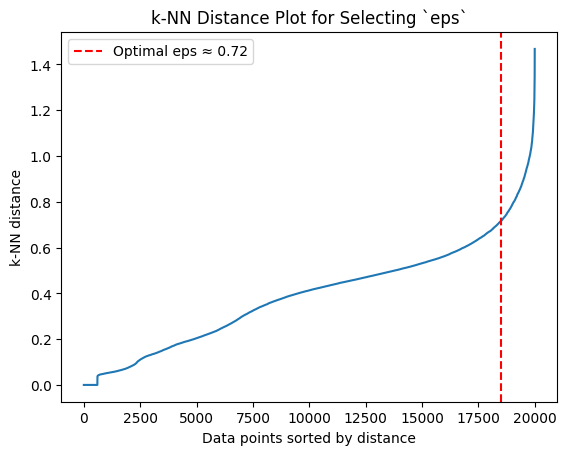

Optimal eps: 0.7178959584844065


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN

# تعیین تعداد نقاط همسایه
k = 50  # به عنوان min_samples انتخاب می‌کنیم

# مدل k-NN برای پیدا کردن نزدیک‌ترین همسایه‌ها
nbrs = NearestNeighbors(n_neighbors=k).fit(final_df)
distances, indices = nbrs.kneighbors(final_df)

# مرتب کردن فاصله‌ها و رسم نمودار
distances = np.sort(distances[:, k-1], axis=0)

# محاسبه مشتق فاصله‌ها
derivative = np.diff(distances)

# پیدا کردن اندیس اولین نقطه‌ای که از یک حد عبور می‌کند
threshold = np.percentile(derivative, 95)  # می‌توانید مقدار درصد را تغییر دهید
eps_index = np.where(derivative > threshold)[0][300]
eps_value = distances[eps_index+5]

# نمایش نتایج
plt.plot(distances)
plt.axvline(eps_index, color='r', linestyle='--', label=f"Optimal eps ≈ {eps_value:.2f}")
plt.ylabel("k-NN distance")
plt.xlabel("Data points sorted by distance")
plt.legend()
plt.title("k-NN Distance Plot for Selecting `eps`")
plt.show()

print("Optimal eps:", eps_value)

In [ ]:
eps_value

0.7178959584844065

In [ ]:
dbscan = DBSCAN(eps=0.4 , min_samples=4)
labels_ = dbscan.fit_predict(final_df)
labels_ = [str(l) for l in labels_]

In [ ]:
pca_2d_data = PCA(n_components=2, random_state=42).fit_transform(final_df)

In [ ]:
px.scatter(x=pca_2d_data[:, 0], y=pca_2d_data[:, 1], color=labels_)

In [ ]:
two_dimensional_data = TSNE(n_components=2, random_state=42).fit_transform(final_df)

In [ ]:
px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)

5 ----- score= -0.05986121632799068


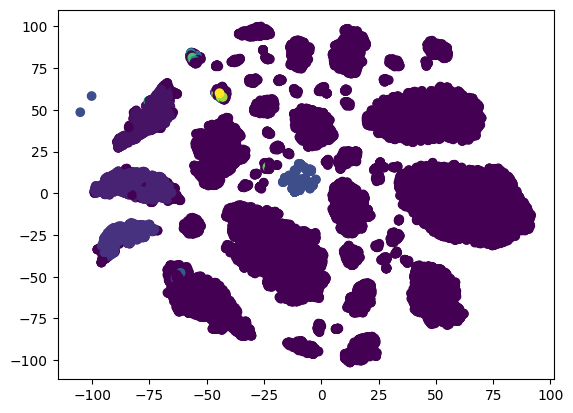

6 ----- score= -0.07038527268159753


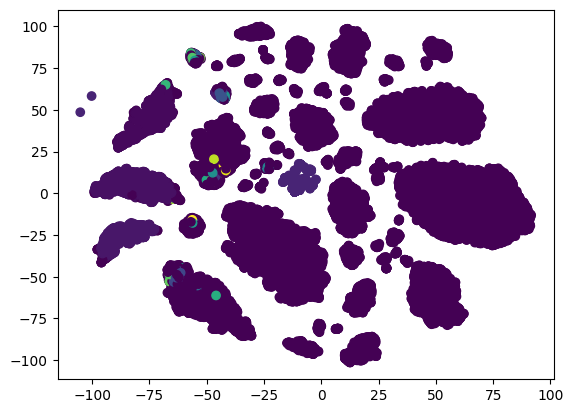

7 ----- score= -0.06455601843019933


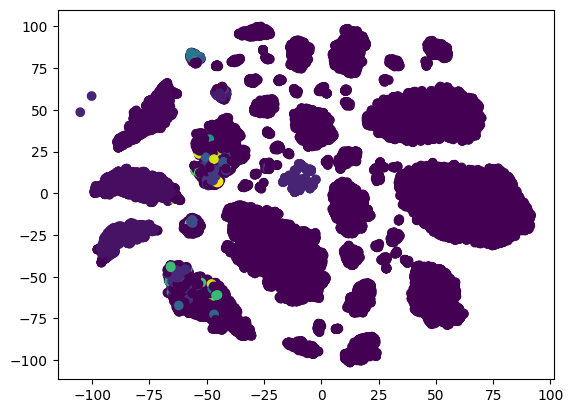

8 ----- score= -0.08469654601972325


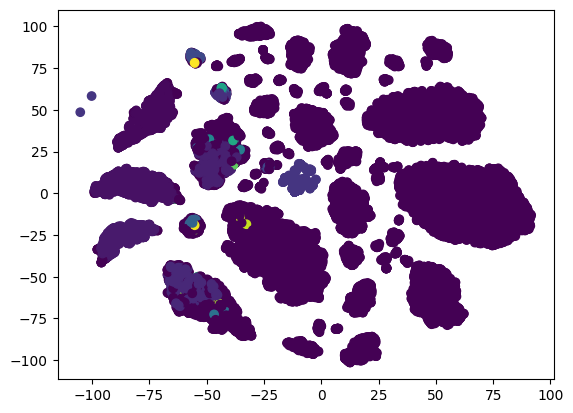

9 ----- score= -0.10134798670603794


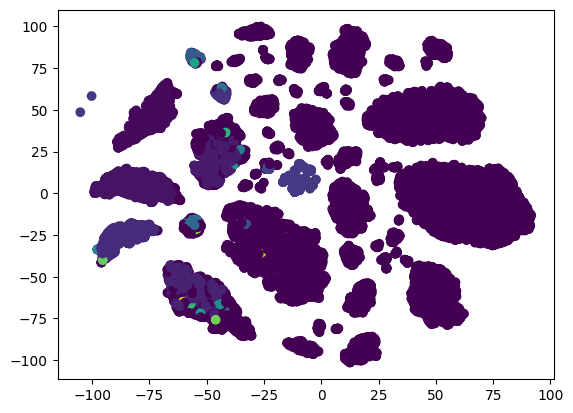

10 ----- score= -0.09249331676761771


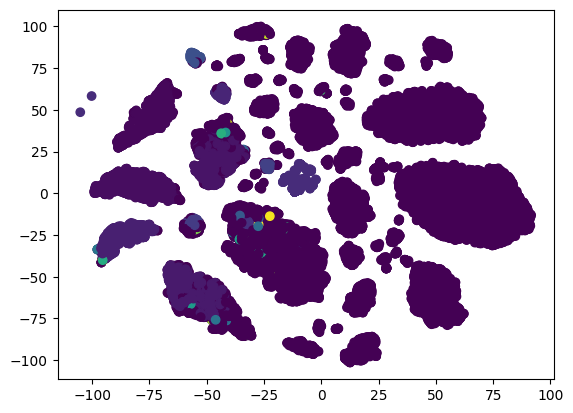

11 ----- score= -0.049096650727735


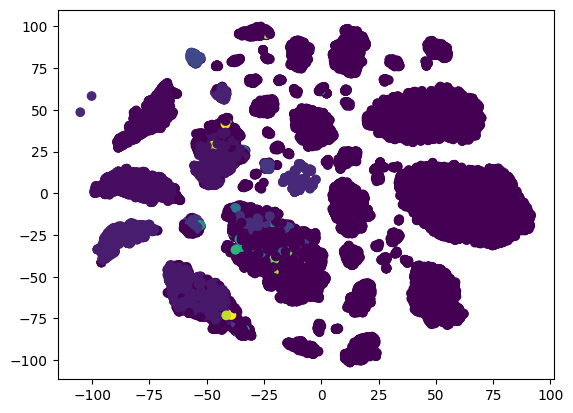

12 ----- score= -0.026959328700975733


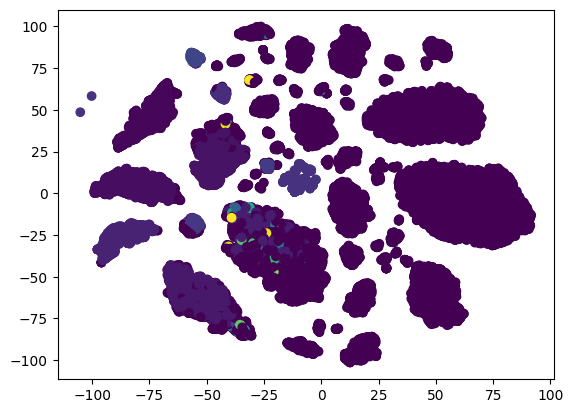

13 ----- score= -0.023270768943263458


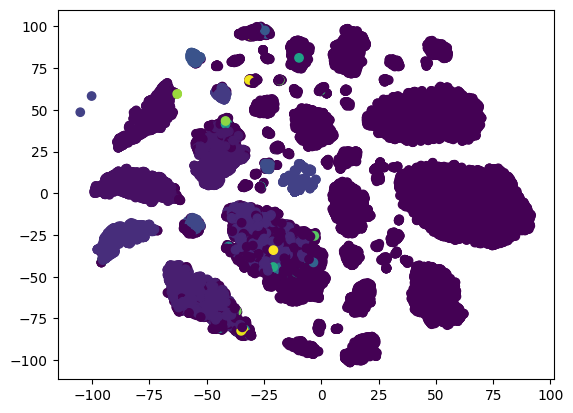

14 ----- score= -0.03208372947482329


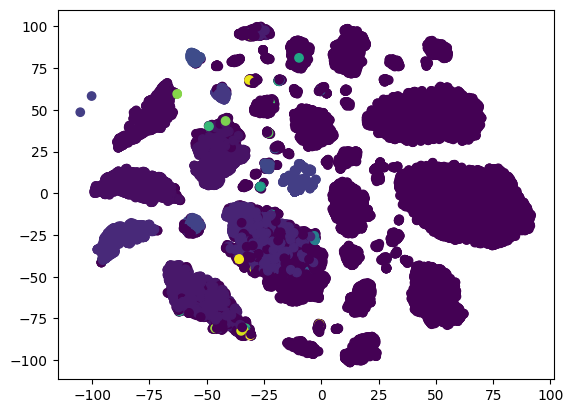

15 ----- score= -0.09294276361191717


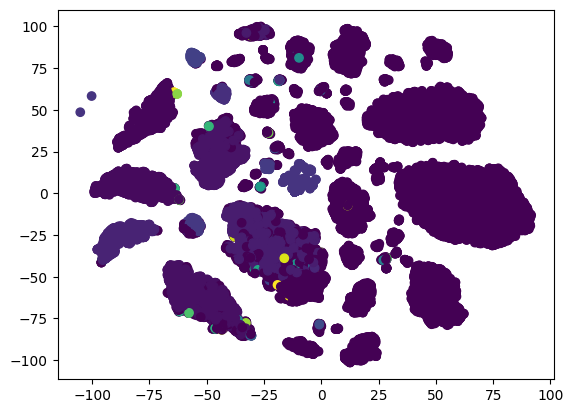

16 ----- score= -0.0783431499632714


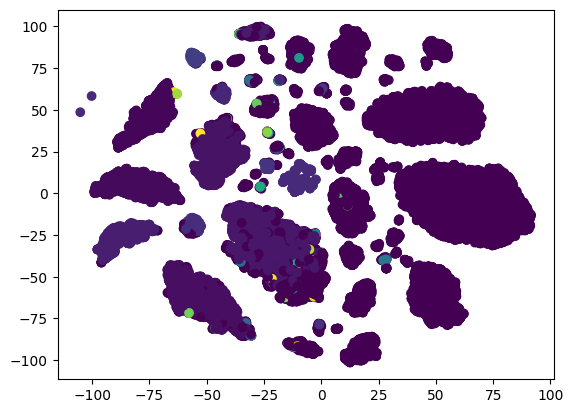

17 ----- score= -0.04503780340036455


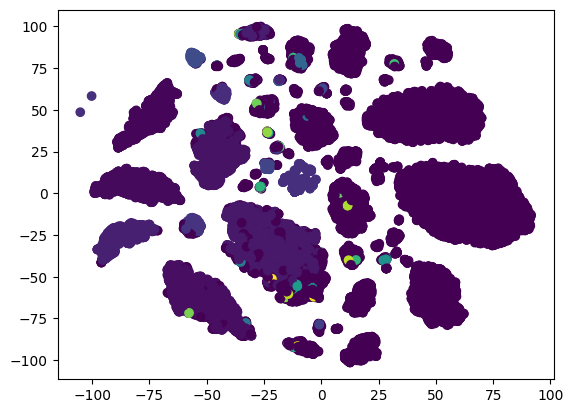

18 ----- score= -0.029729473836268325


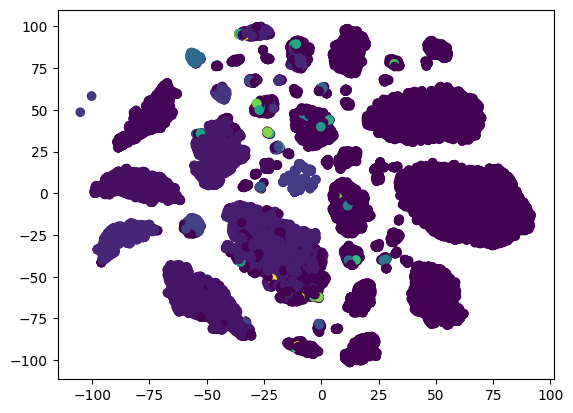

19 ----- score= -0.06026848347661728


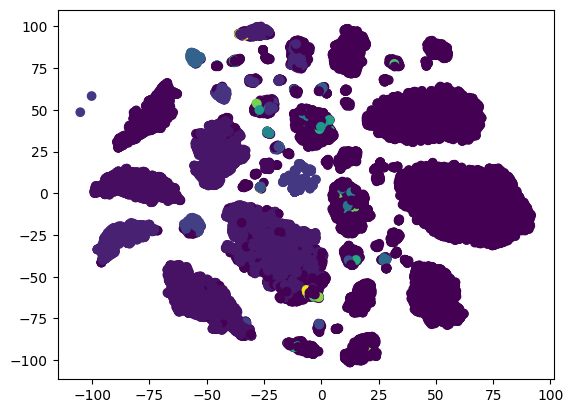

20 ----- score= -0.06265223533690768


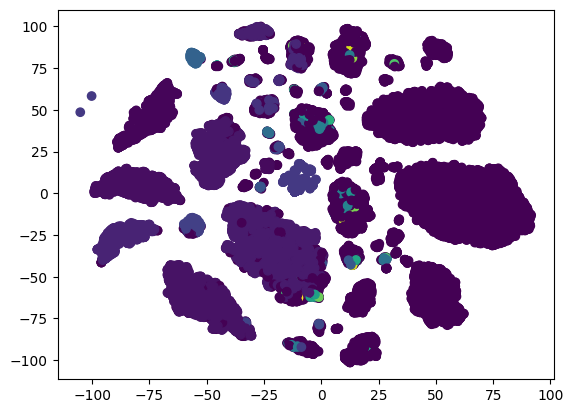

21 ----- score= -0.06963035892783419


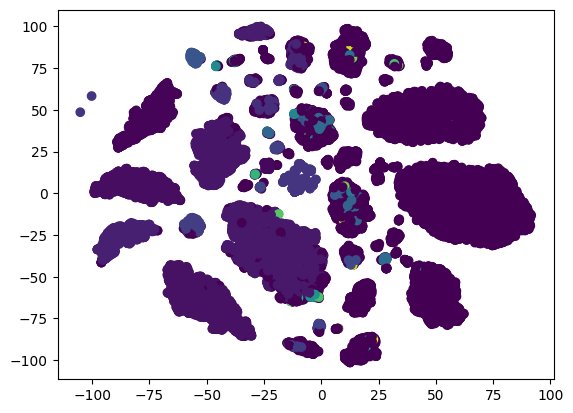

22 ----- score= -0.03047595198653093


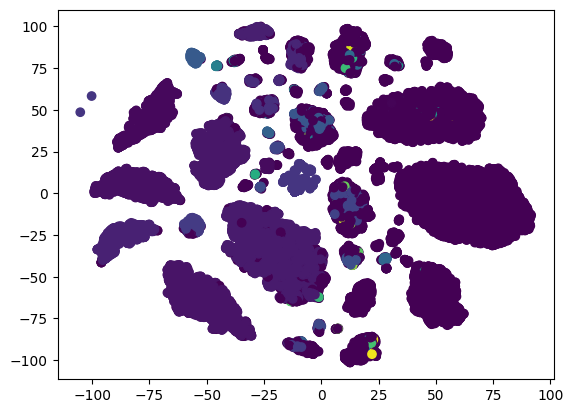

23 ----- score= -0.06476492315511659


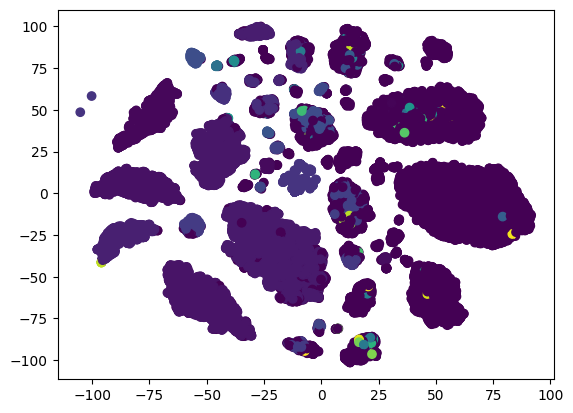

24 ----- score= -0.06239274405027915


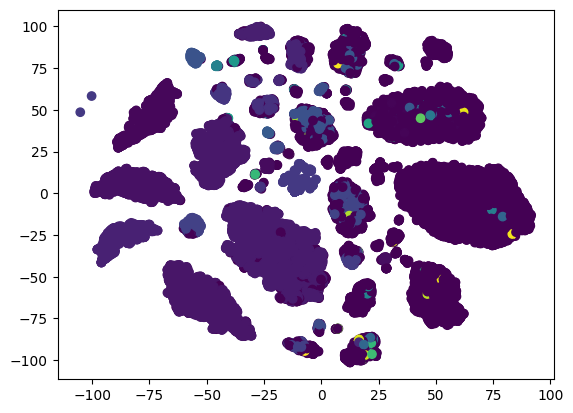

25 ----- score= -0.08260202806473117


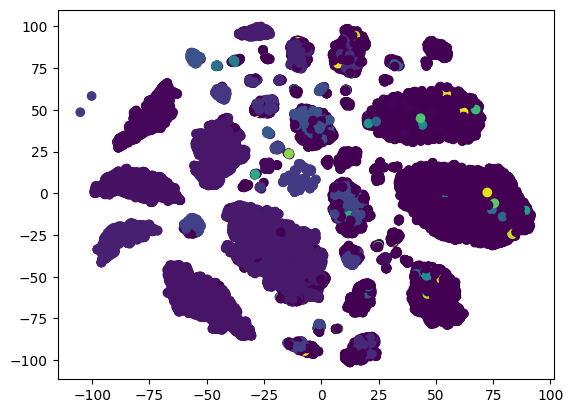

26 ----- score= -0.05524576570291033


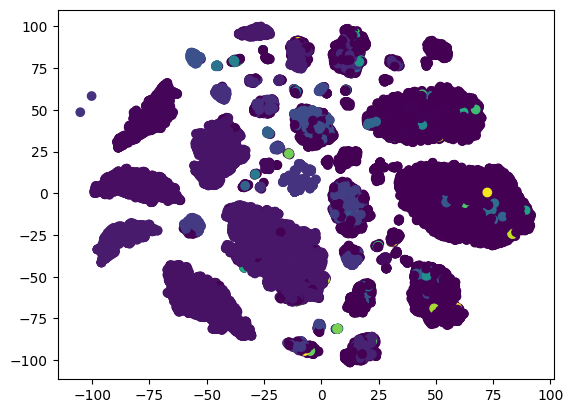

27 ----- score= -0.012095340568223428


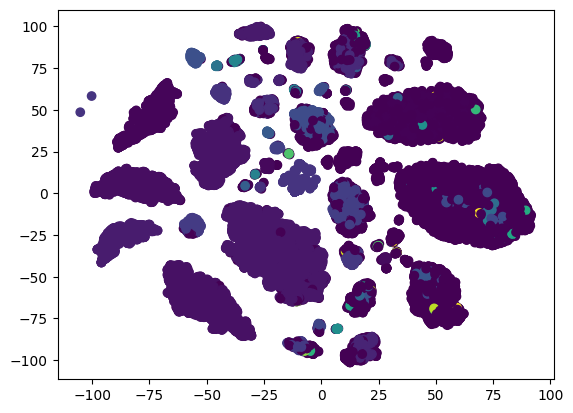

28 ----- score= 0.021154585614309617


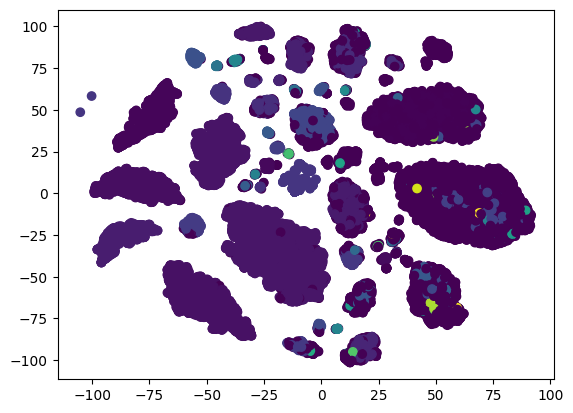

29 ----- score= 0.036748998712145146


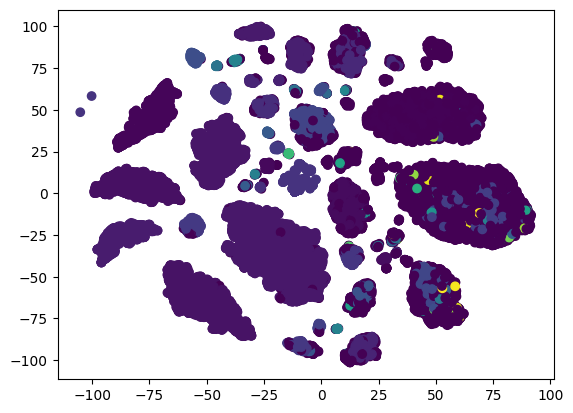

30 ----- score= 0.07435883273004697


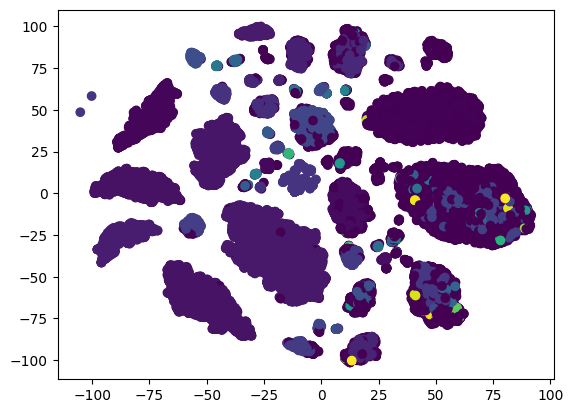

31 ----- score= 0.08981487054228564


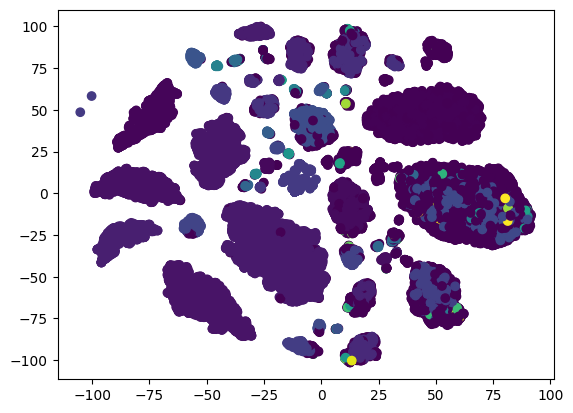

32 ----- score= 0.10661199670546484


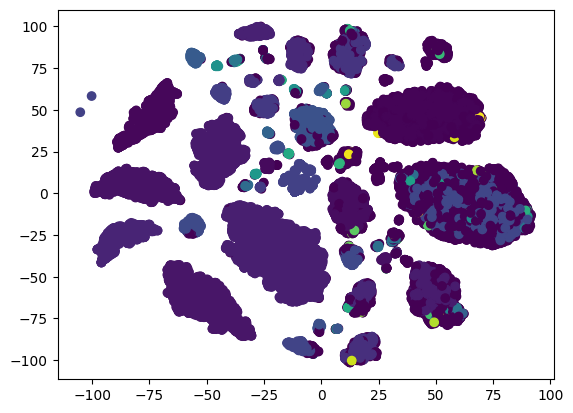

33 ----- score= 0.1182274378203495


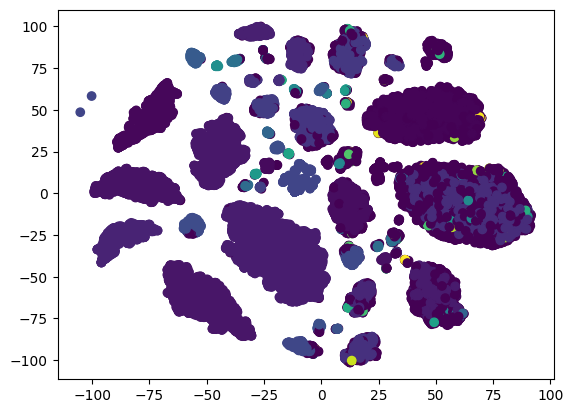

34 ----- score= 0.14229770608749367


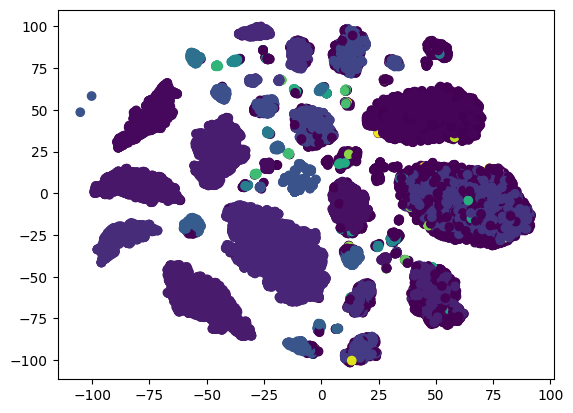

35 ----- score= 0.16835714193599685


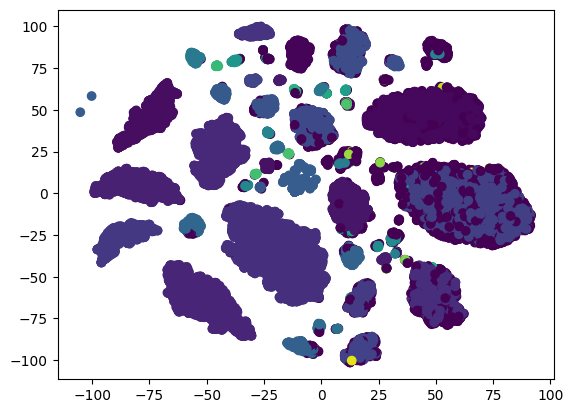

36 ----- score= 0.20921215078762206


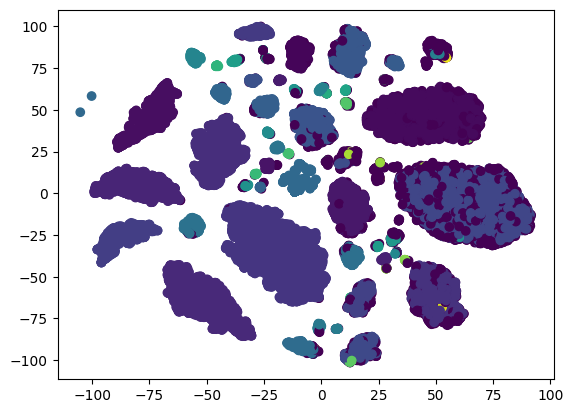

37 ----- score= 0.23401619798071197


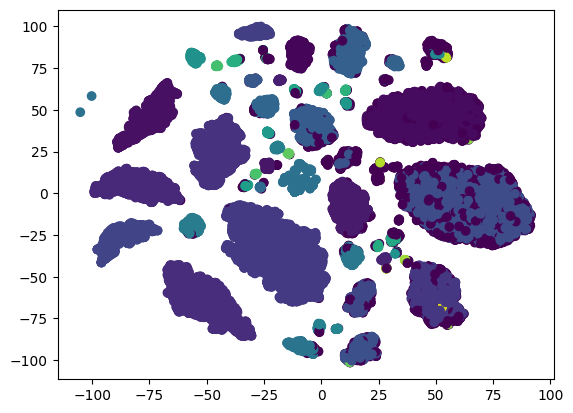

38 ----- score= 0.2325978138883497


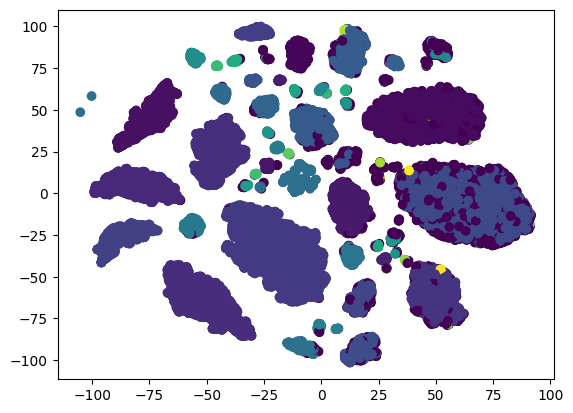

39 ----- score= 0.2599891801644564


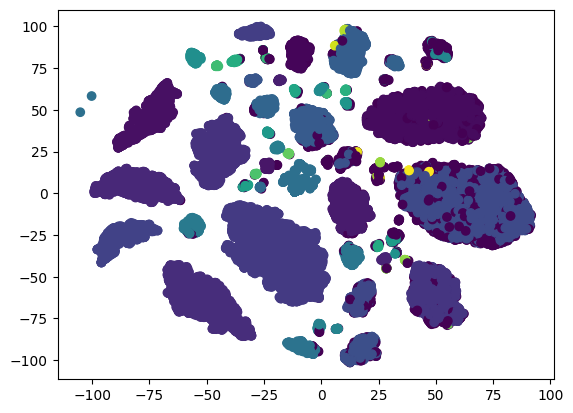

40 ----- score= 0.283908804370055


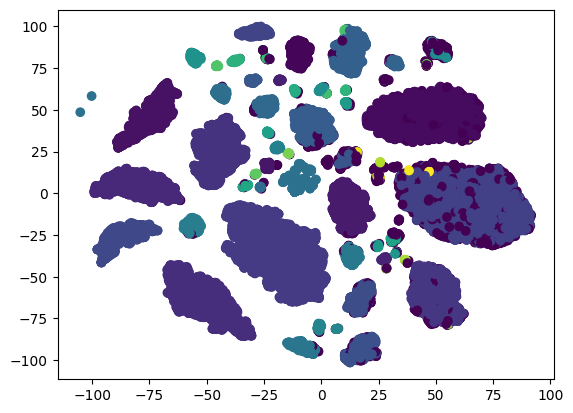

41 ----- score= 0.3015206969176859


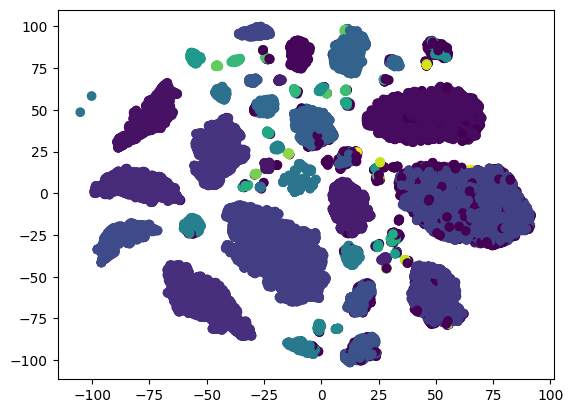

42 ----- score= 0.34639342058767253


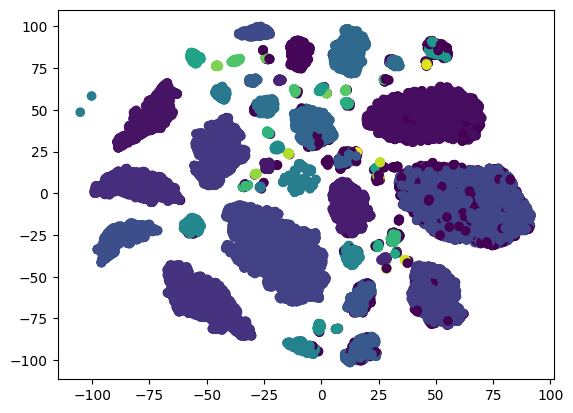

43 ----- score= 0.3495108163007875


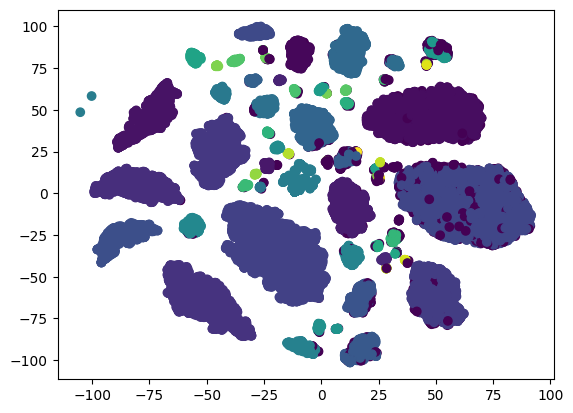

44 ----- score= 0.33052584233524707


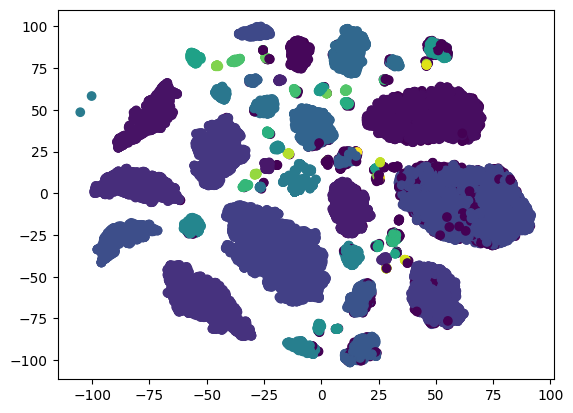

45 ----- score= 0.3505275666800773


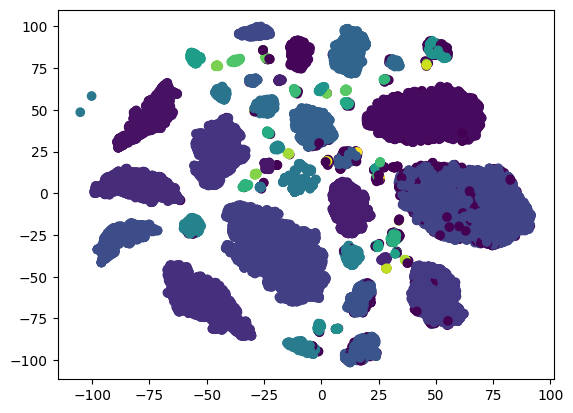

46 ----- score= 0.34511270868150506


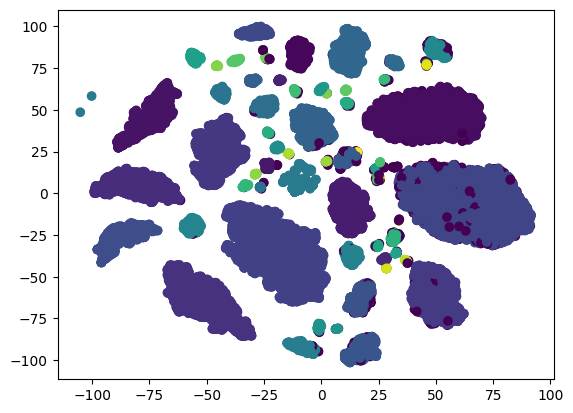

47 ----- score= 0.35728671965260916


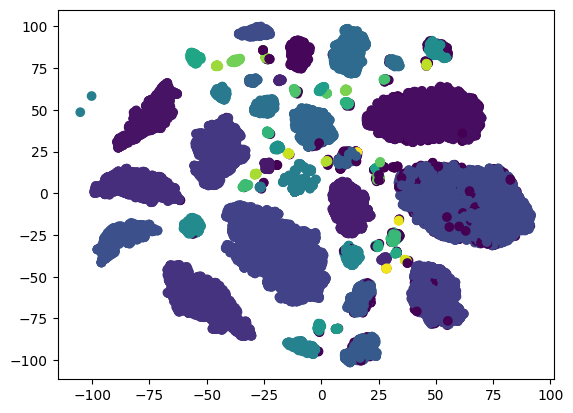

48 ----- score= 0.3625099837362456


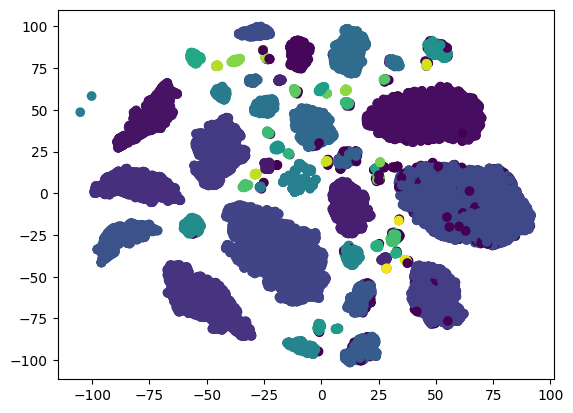

49 ----- score= 0.3127627726494805


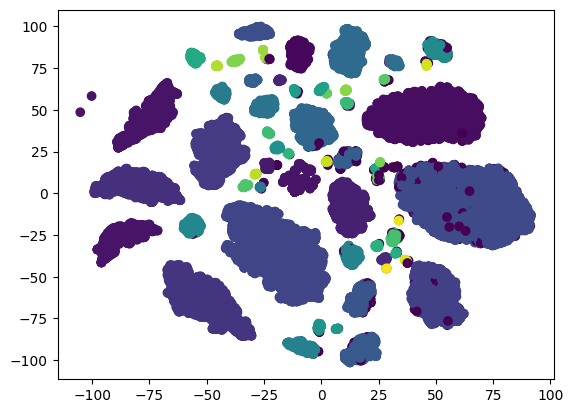

50 ----- score= 0.2746856536918616


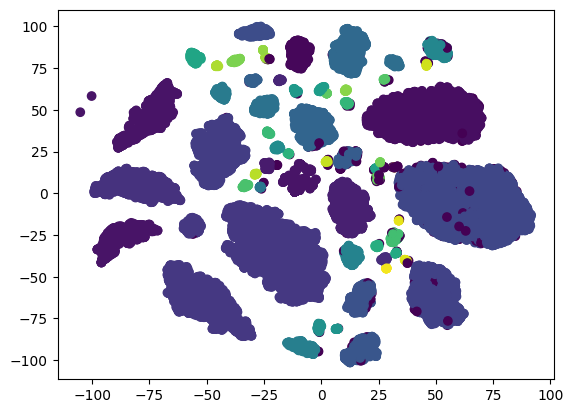

51 ----- score= 0.25280653048650037


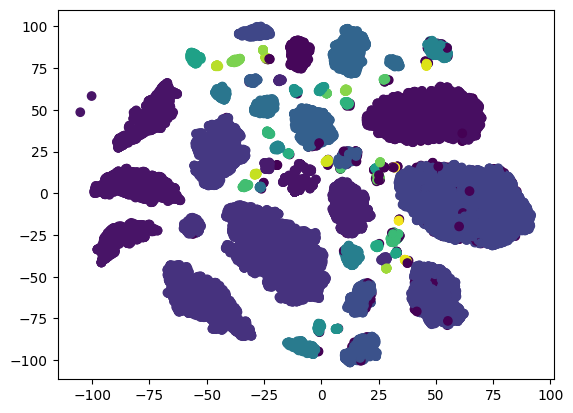

52 ----- score= 0.14236535580404494


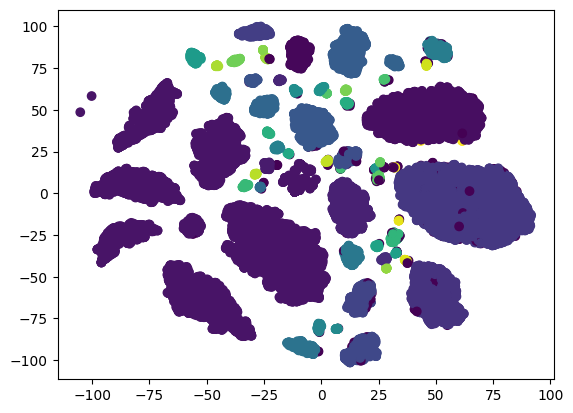

53 ----- score= 0.13762240162158149


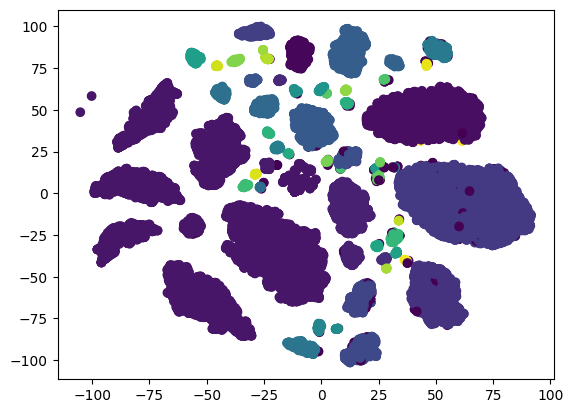

54 ----- score= 0.13633566994146995


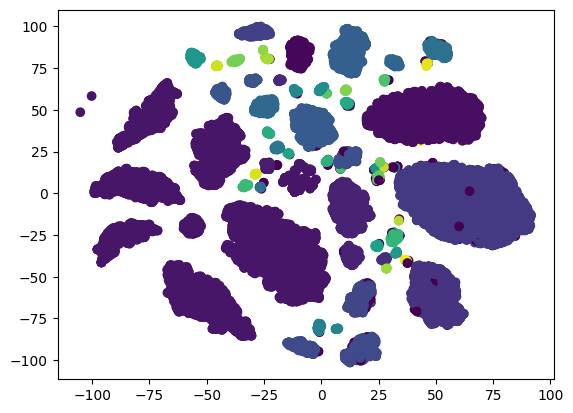

55 ----- score= 0.14454574930282202


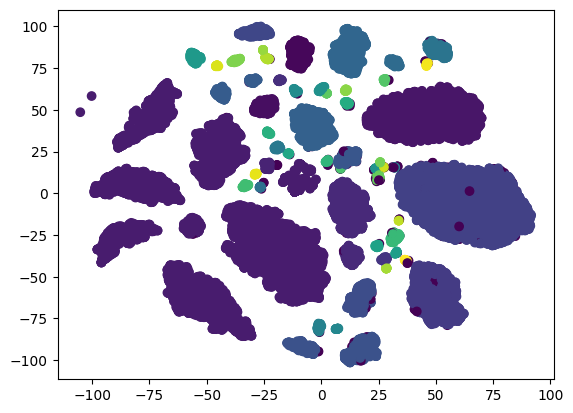

56 ----- score= 0.14321055249517192


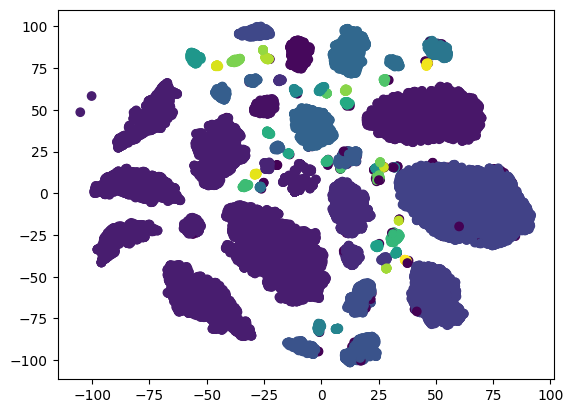

57 ----- score= 0.14666863314762776


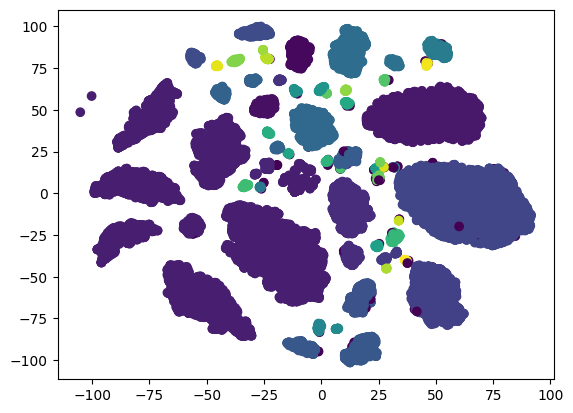

58 ----- score= 0.13144717530247604


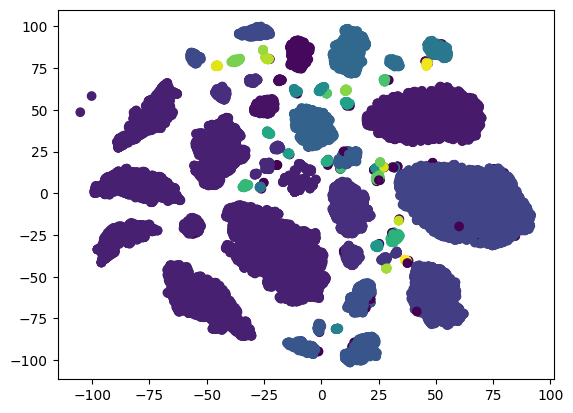

59 ----- score= 0.12249778304776532


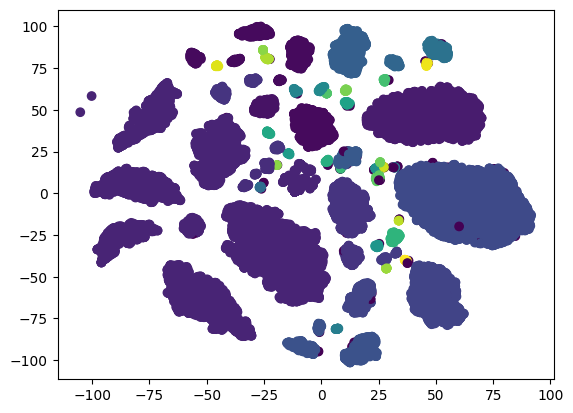

60 ----- score= 0.11601381226720155


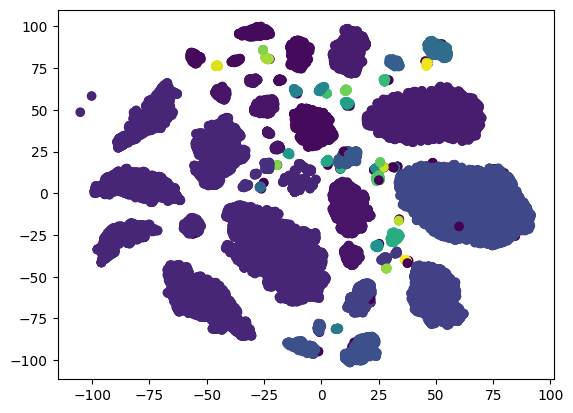

61 ----- score= 0.11896442730736667


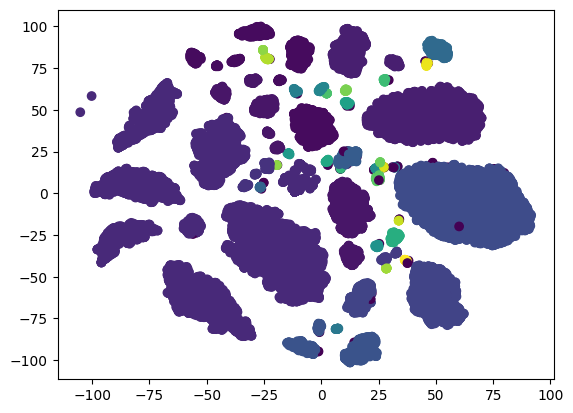

62 ----- score= 0.1257574544544037


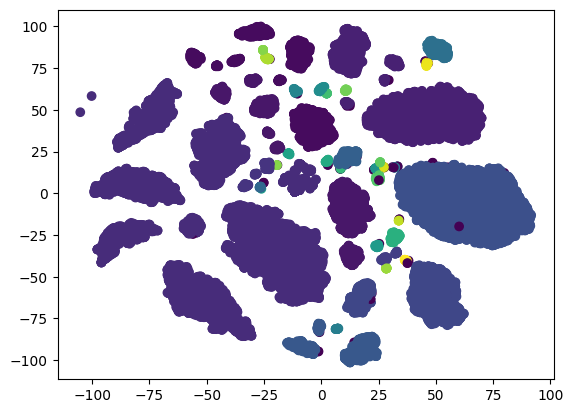

63 ----- score= 0.14857271326291033


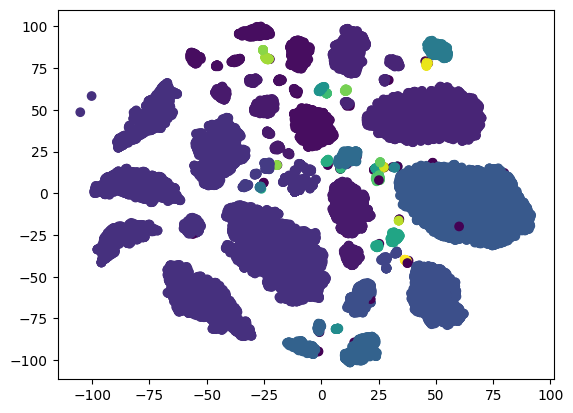

64 ----- score= 0.18537426148649147


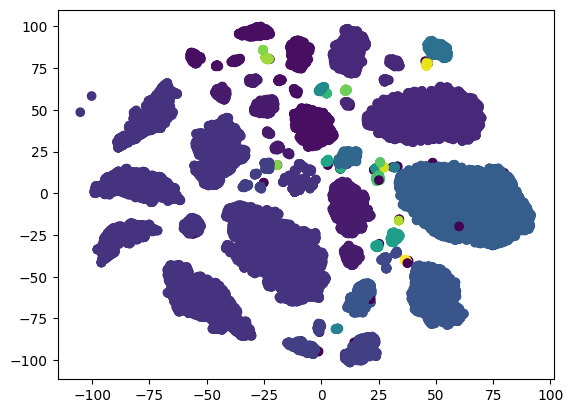

65 ----- score= 0.1516570937557836


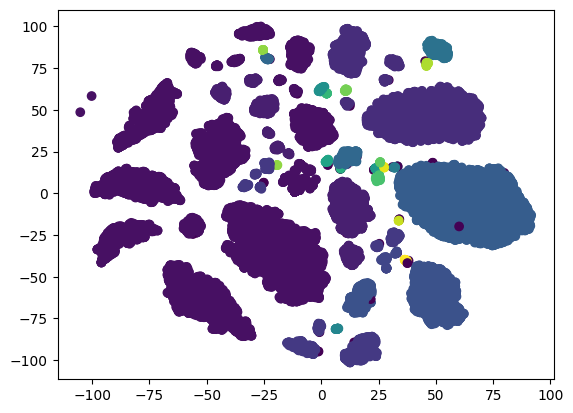

66 ----- score= 0.16034867298930927


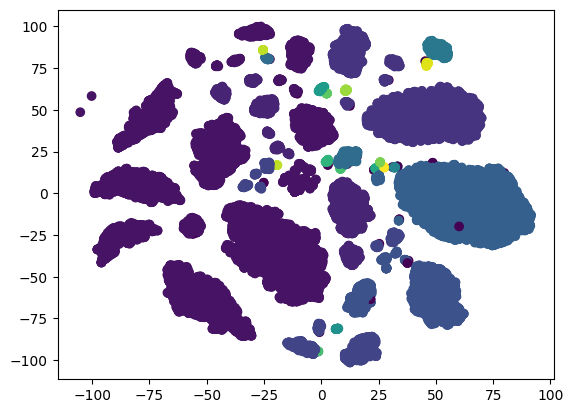

67 ----- score= 0.15302587360695802


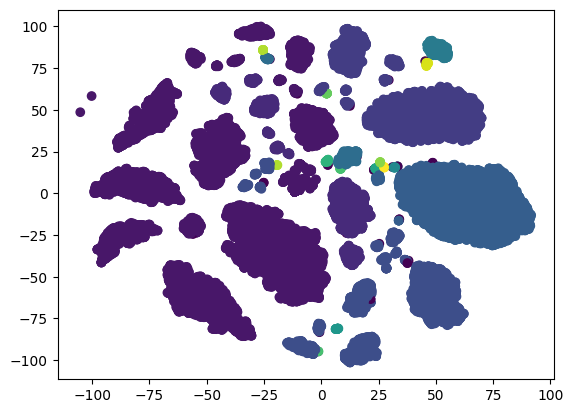

68 ----- score= 0.15881280991633207


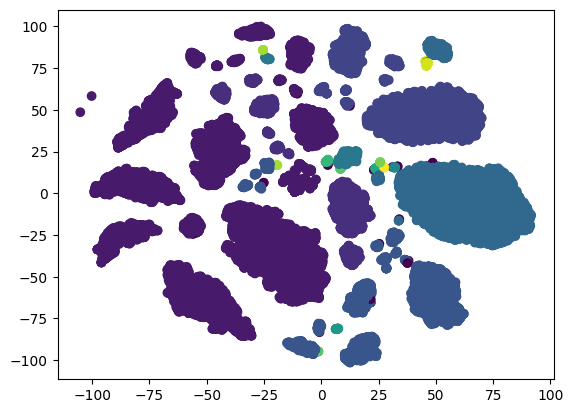

69 ----- score= 0.16148851826578844


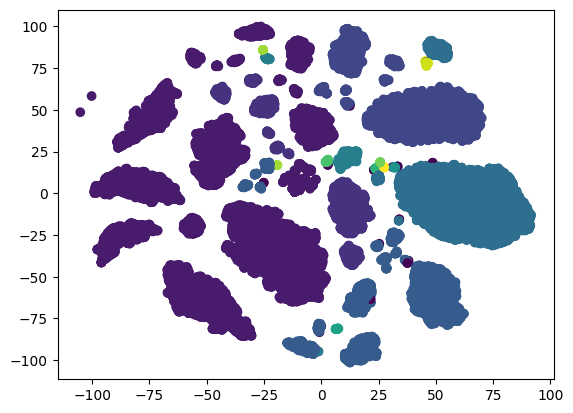

70 ----- score= 0.17793988612955672


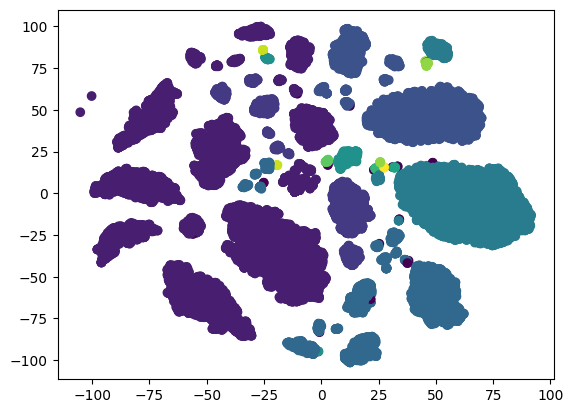

71 ----- score= 0.035836702601743306


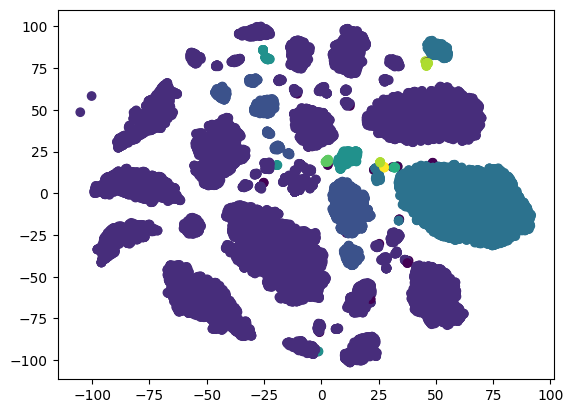

72 ----- score= 0.09111534256138769


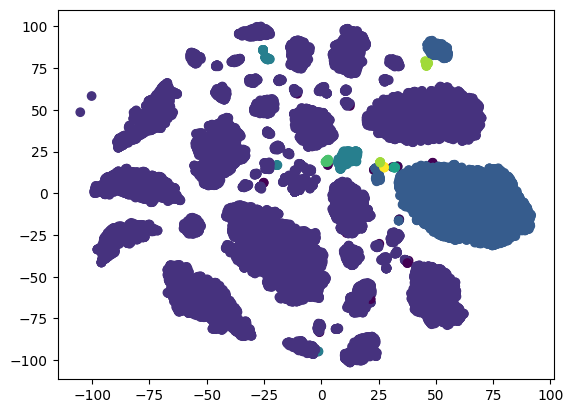

73 ----- score= -0.0021696351468823943


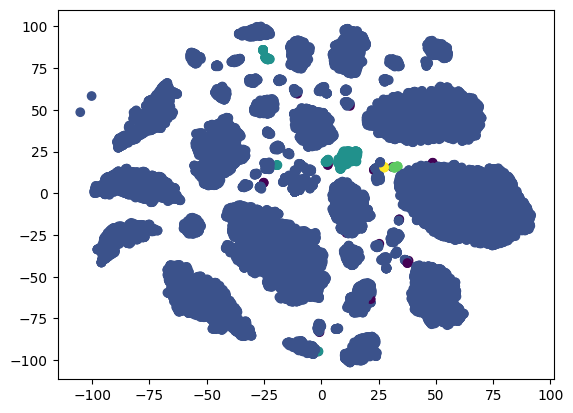

74 ----- score= 0.058573227640554365


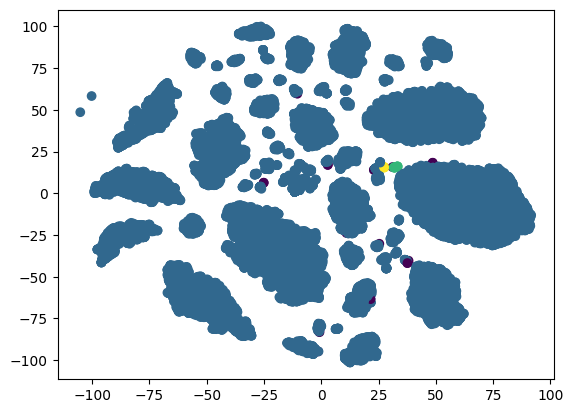

75 ----- score= 0.059953540570931545


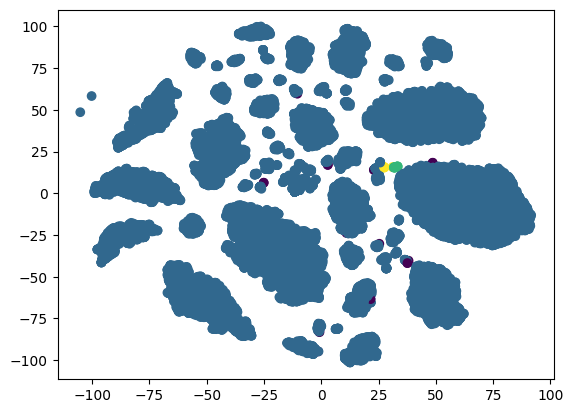

76 ----- score= 0.072805541007214


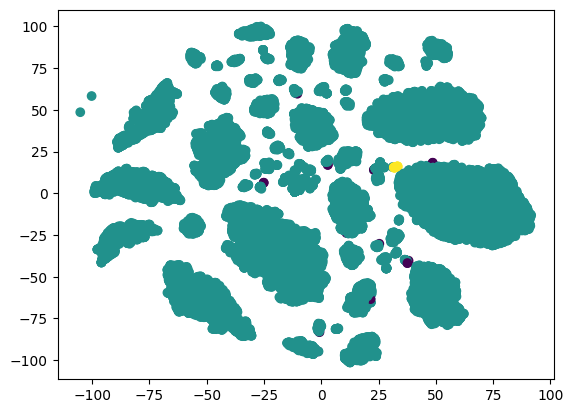

77 ----- score= 0.18845233127416341


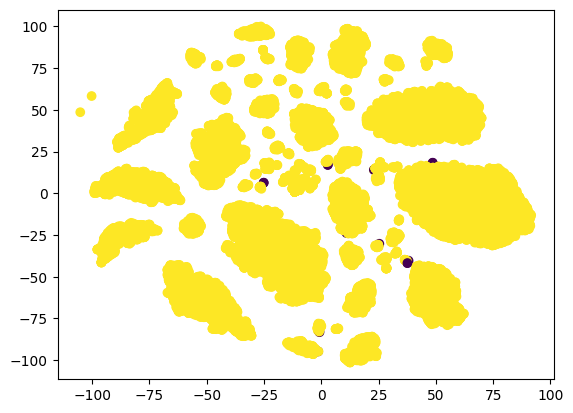

78 ----- score= 0.18839664537913495


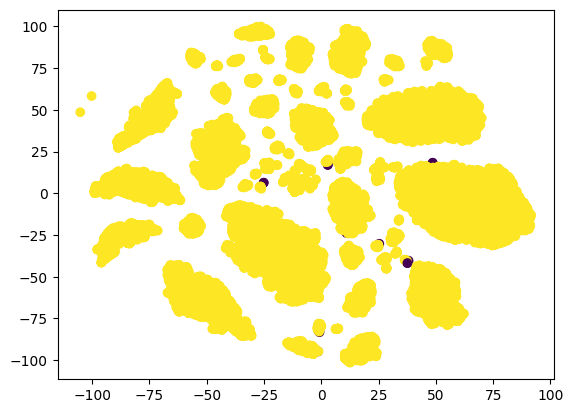

79 ----- score= 0.20131505895119464


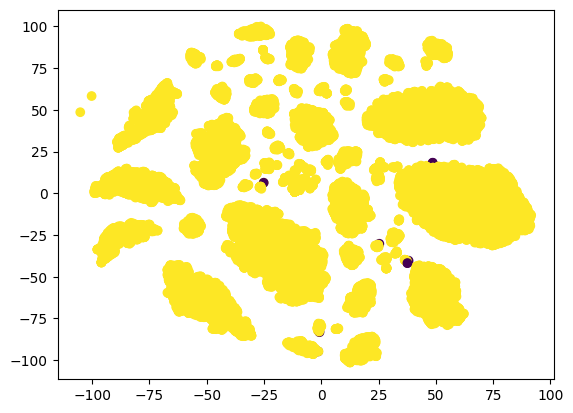

80 ----- score= 0.21184040310449642


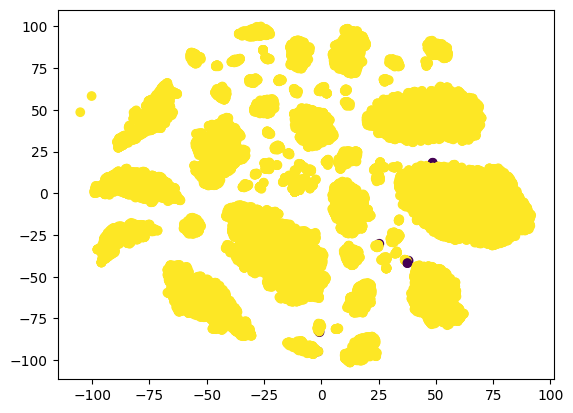

81 ----- score= 0.21184040310449642


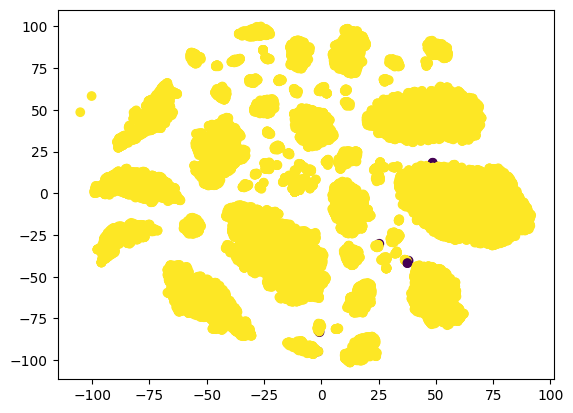

82 ----- score= 0.21278493993333997


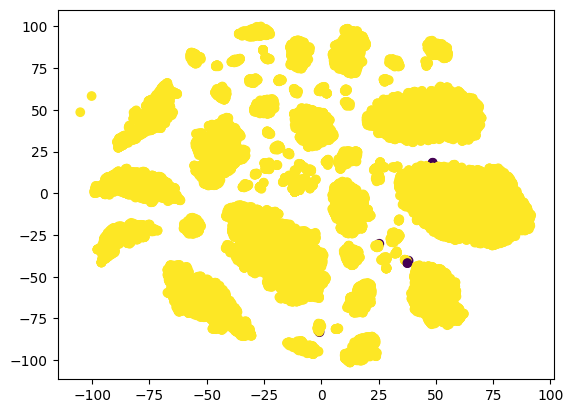

83 ----- score= 0.21278493993333997


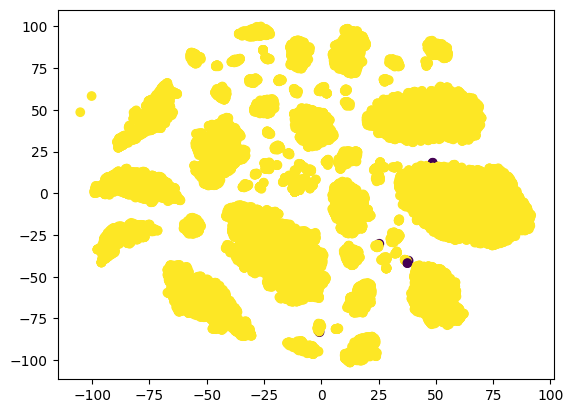

84 ----- score= 0.21278493993333997


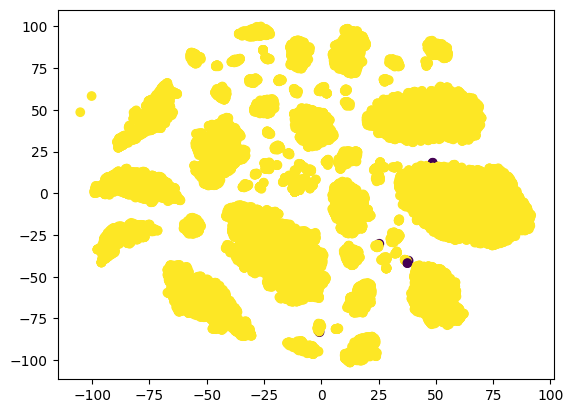

85 ----- score= 0.21278493993333997


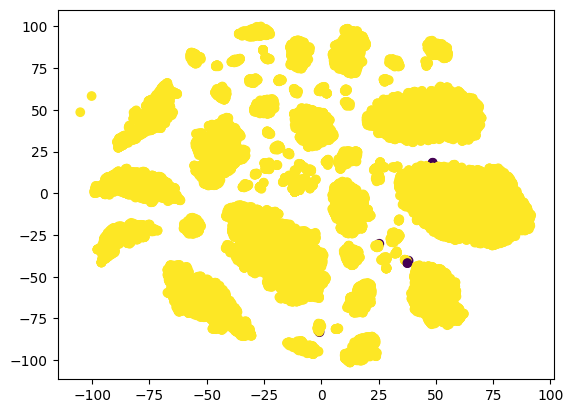

86 ----- score= 0.21278493993333997


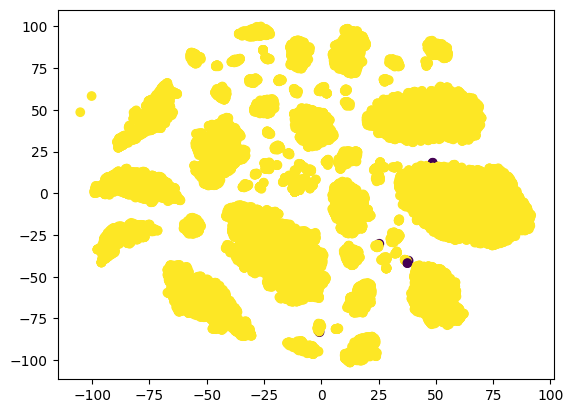

87 ----- score= 0.20538873702349278


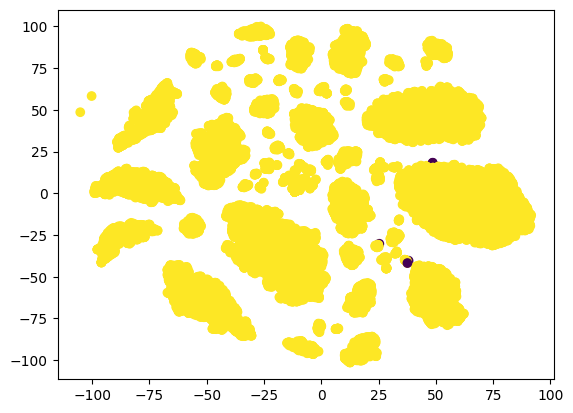

88 ----- score= 0.20538873702349278


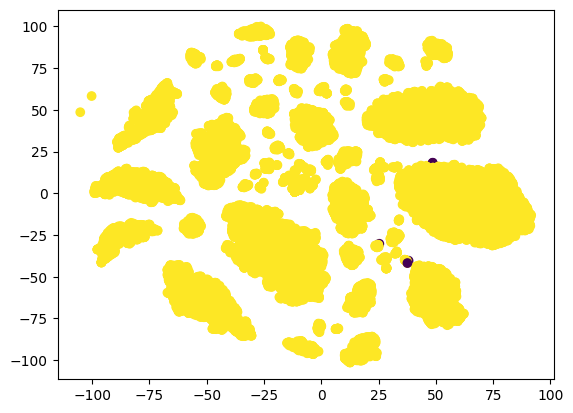

89 ----- score= 0.20538873702349278


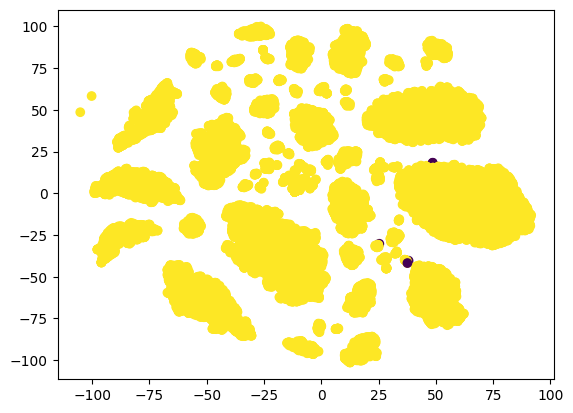

In [ ]:
# dbscan = DBSCAN(eps=0.15, min_samples=50)
# labels_ = dbscan.fit_predict(scaled_data)
# labels_ = [str(l) for l in labels_]
scores =[]
for i in range(5,90,1):
  dbscan = DBSCAN(eps=i/100, min_samples=4)
  labels_ = dbscan.fit_predict(final_df)
  labels_ = [str(l) for l in labels_]
  score=silhouette_score(final_df,dbscan.labels_)
  scores.append(score)
  print(i,"----- score=",score)
  plt.scatter([x[0] for x in two_dimensional_data], [x[1] for x in two_dimensional_data], c=dbscan.labels_)
  plt.show()
  # fig=px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)
  # fig.show()

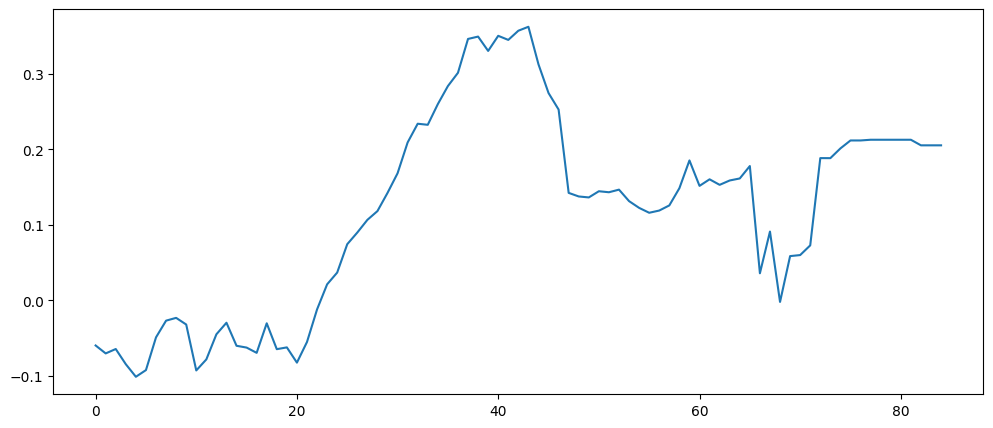

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(range(len(scores)), scores)
plt.show()

450 ----- score= 0.3505275666800773


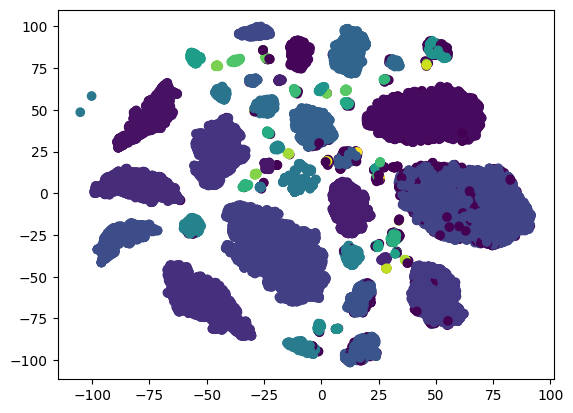

451 ----- score= 0.3506492358194423


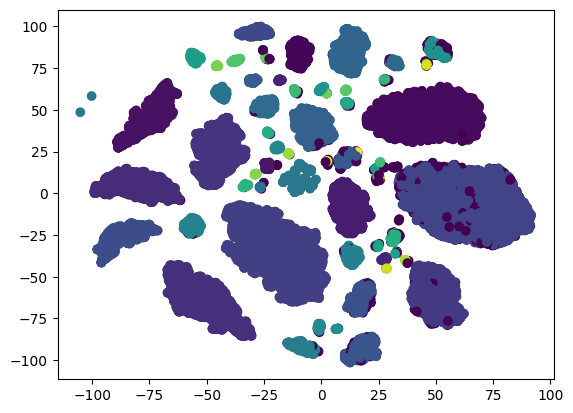

452 ----- score= 0.35097315831941067


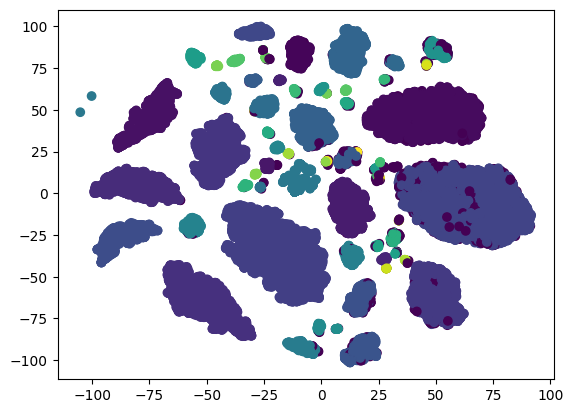

453 ----- score= 0.35159313961285615


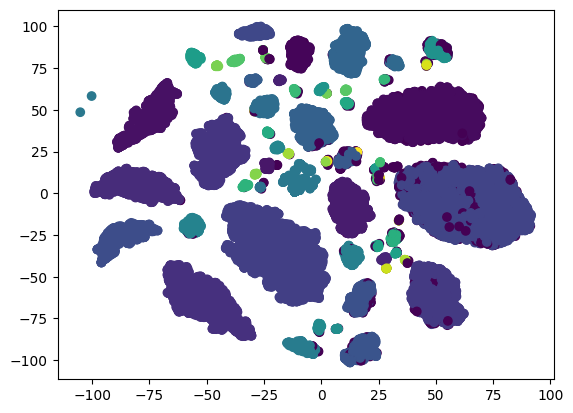

454 ----- score= 0.34190840588555427


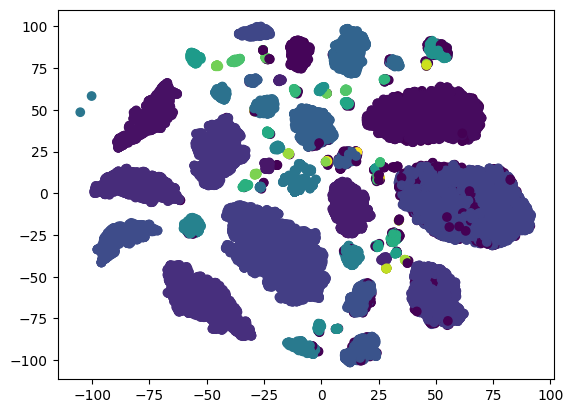

455 ----- score= 0.34370398641987404


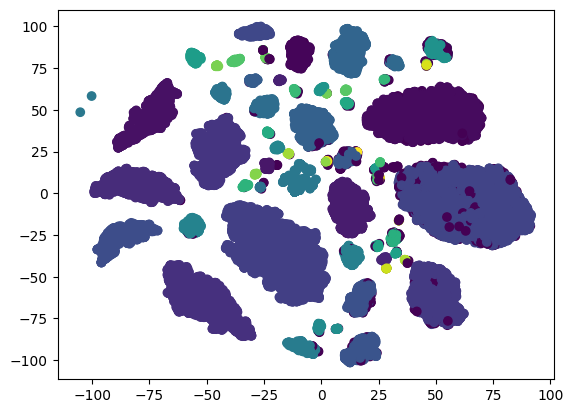

456 ----- score= 0.3439430313425629


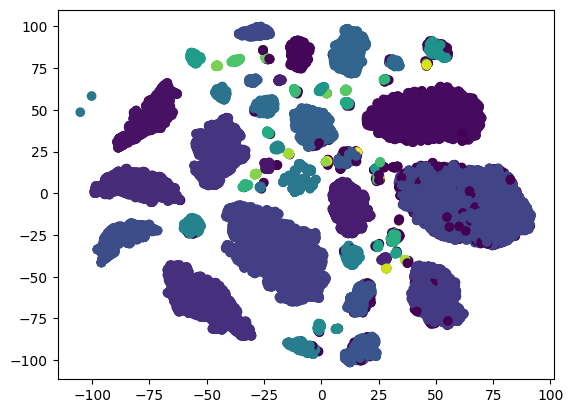

457 ----- score= 0.3440870594536062


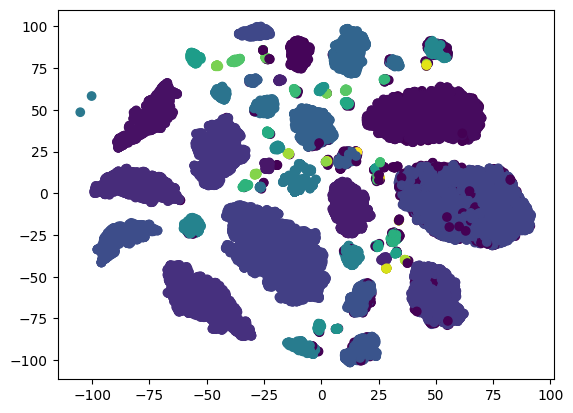

458 ----- score= 0.3446513090669879


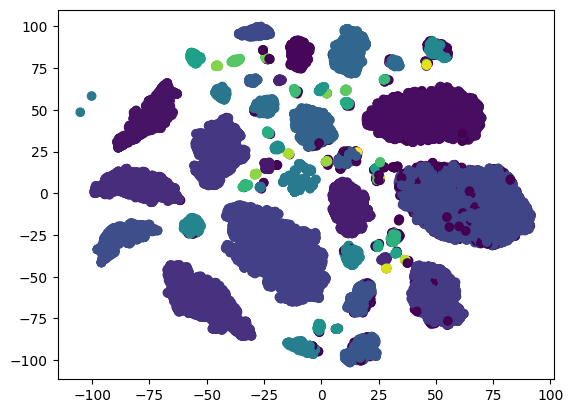

459 ----- score= 0.34493464572850363


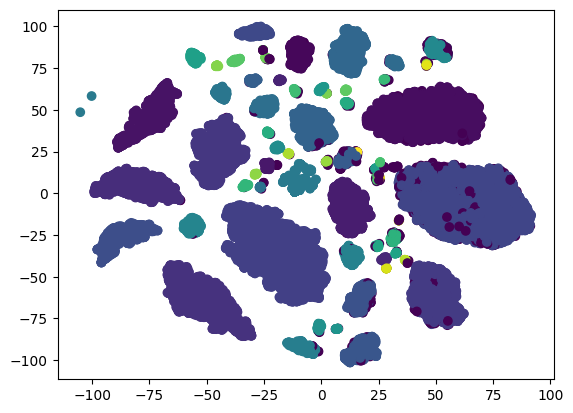

460 ----- score= 0.34511270868150506


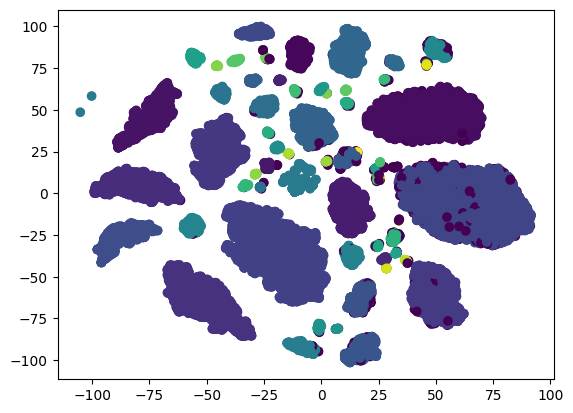

461 ----- score= 0.34523631591471277


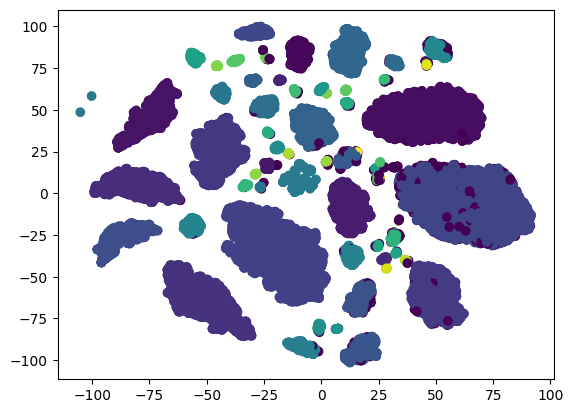

462 ----- score= 0.3454435076908798


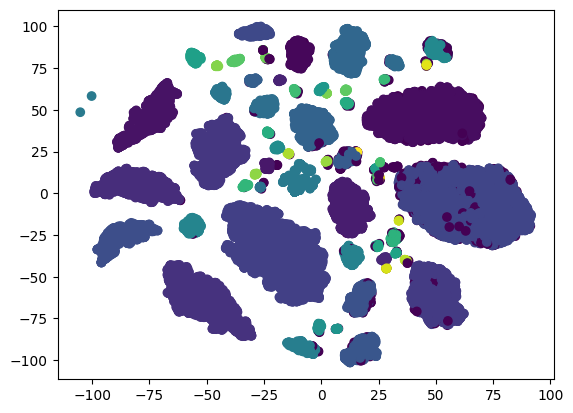

463 ----- score= 0.34557414696985606


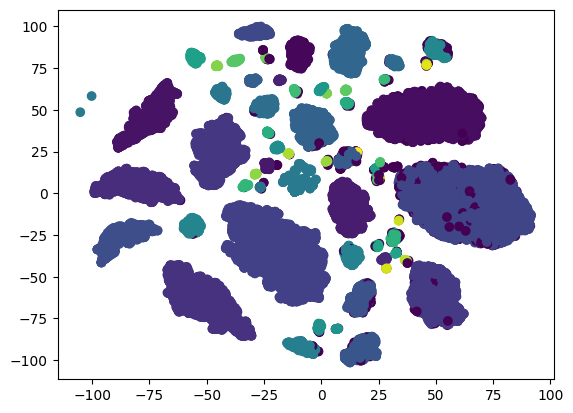

464 ----- score= 0.3458127724357727


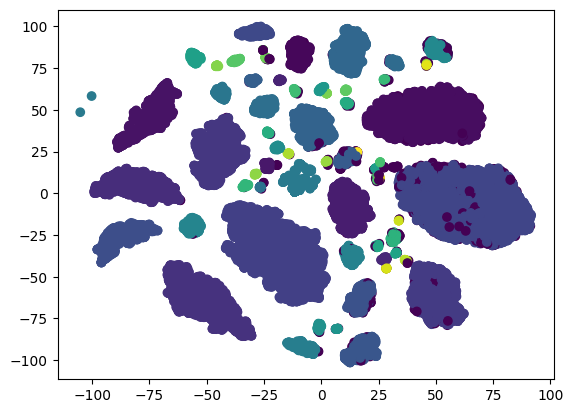

465 ----- score= 0.34584802673124965


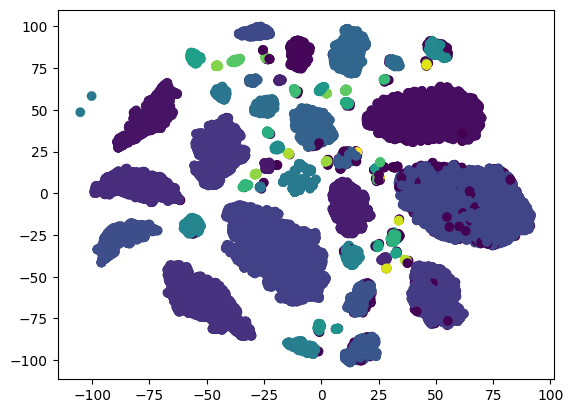

466 ----- score= 0.3460058869835974


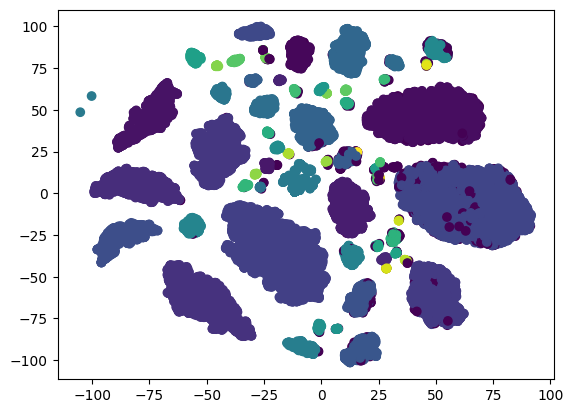

467 ----- score= 0.3465697555476595


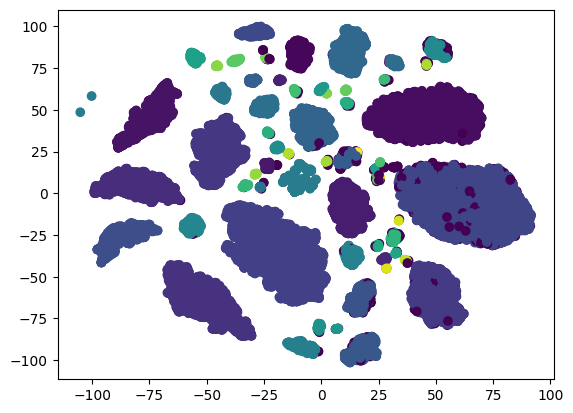

468 ----- score= 0.3466348004904991


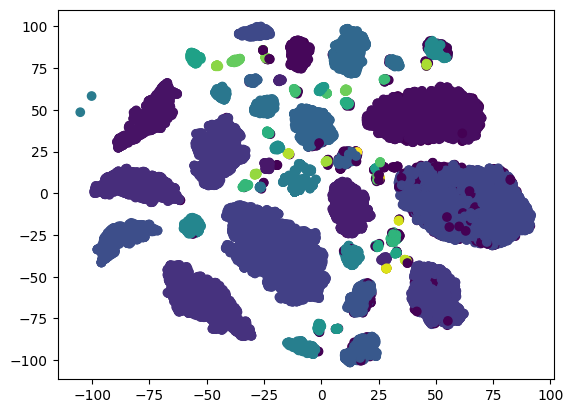

469 ----- score= 0.357134624676807


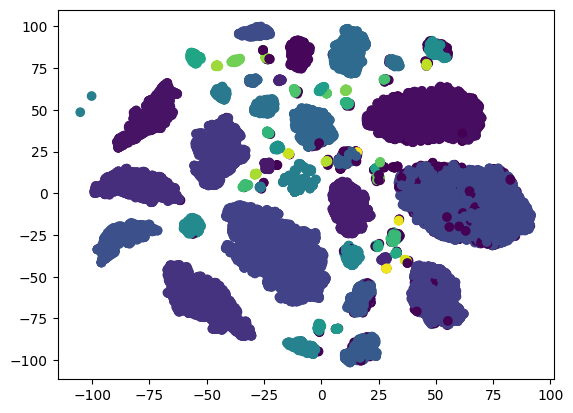

In [ ]:
# dbscan = DBSCAN(eps=0.15, min_samples=50)
# labels_ = dbscan.fit_predict(scaled_data)
# labels_ = [str(l) for l in labels_]
scores =[]
for i in range(450,470,1):
  dbscan = DBSCAN(eps=i/1000, min_samples=4)
  labels_ = dbscan.fit_predict(final_df)
  labels_ = [str(l) for l in labels_]
  score=silhouette_score(final_df,dbscan.labels_)
  scores.append(score)
  print(i,"----- score=",score)
  plt.scatter([x[0] for x in two_dimensional_data], [x[1] for x in two_dimensional_data], c=dbscan.labels_)
  plt.show()
  # fig=px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)
  # fig.show()

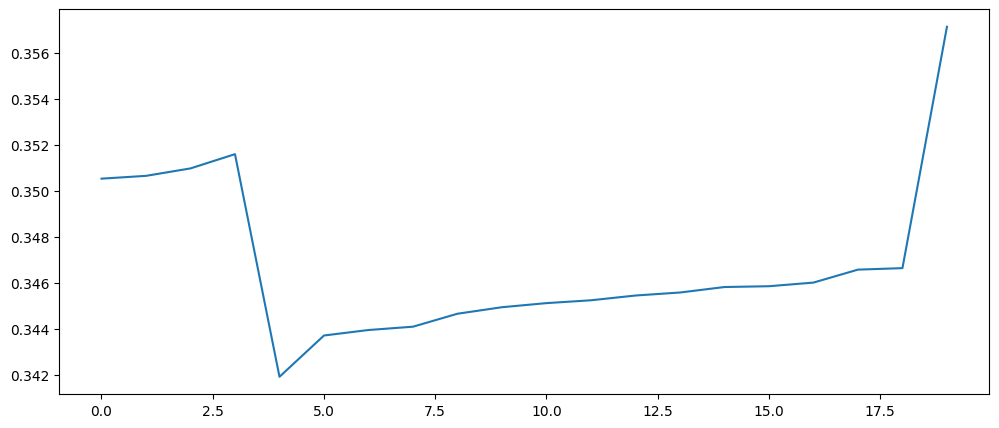

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(range(len(scores)), scores)
plt.show()

1 ----- score= 0.1285595917761119


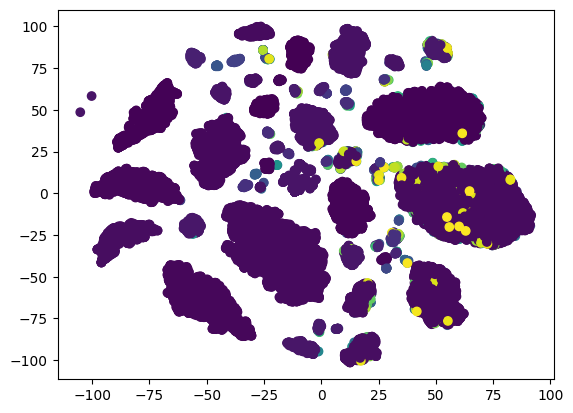

2 ----- score= 0.2949878799398033


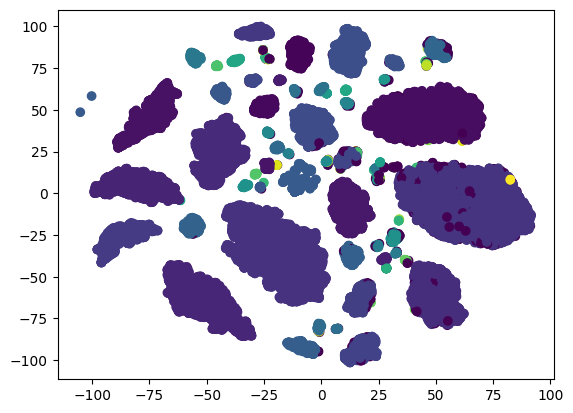

3 ----- score= 0.34808280063147223


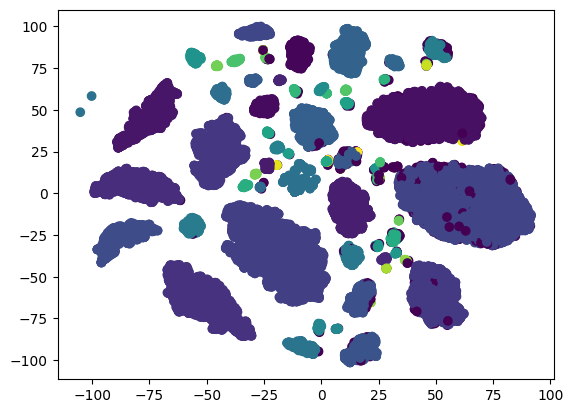

4 ----- score= 0.3460058869835974


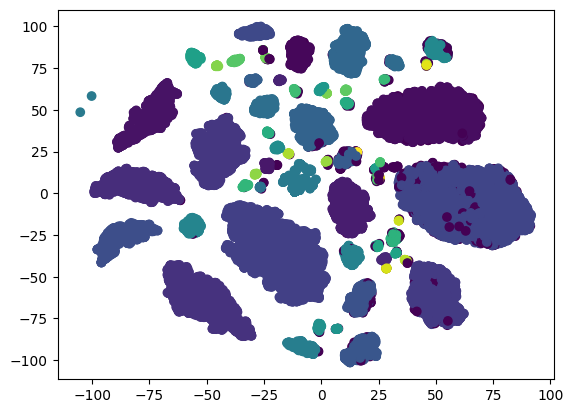

5 ----- score= 0.3546917348891072


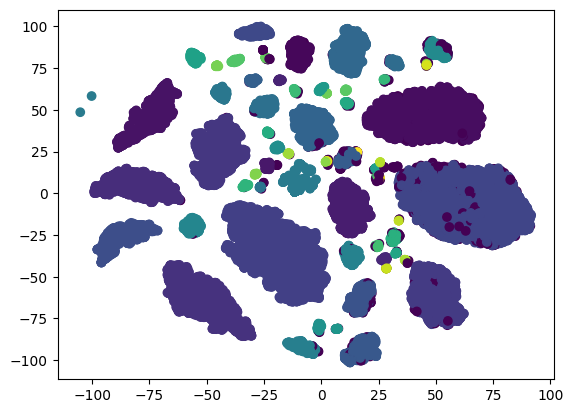

6 ----- score= 0.36177147246471447


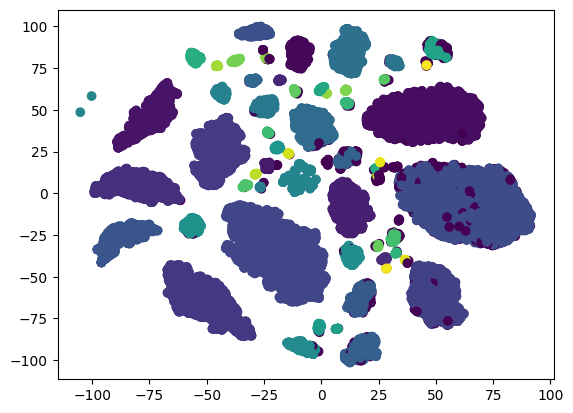

7 ----- score= 0.36052672522408047


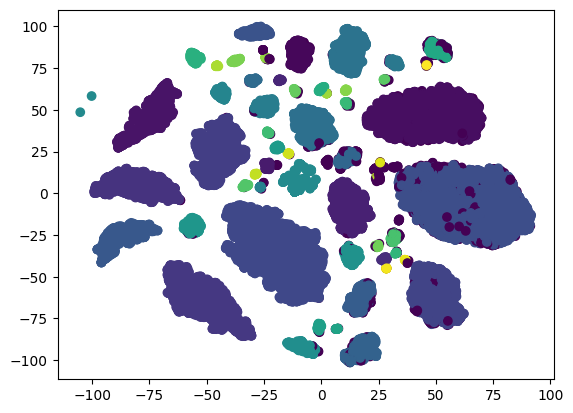

8 ----- score= 0.35903330490109764


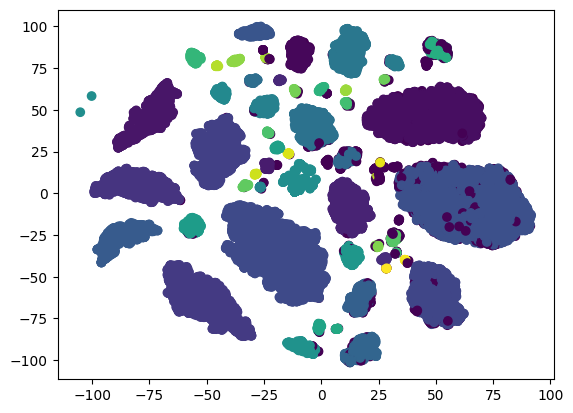

9 ----- score= 0.35788752305984284


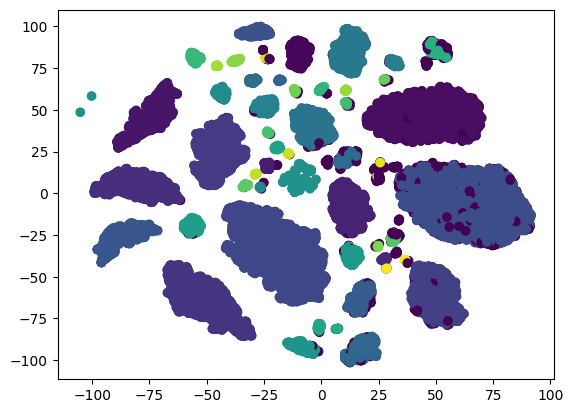

10 ----- score= 0.3565779626430594


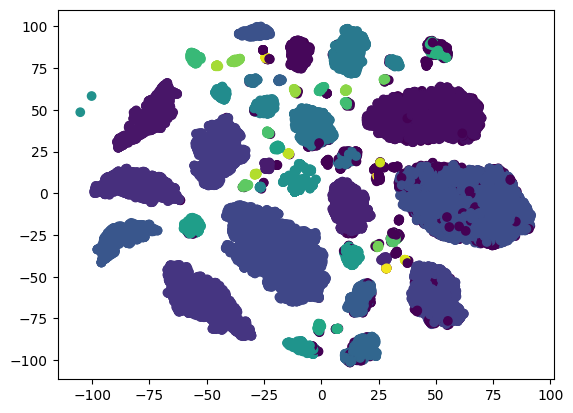

11 ----- score= 0.3561219141720373


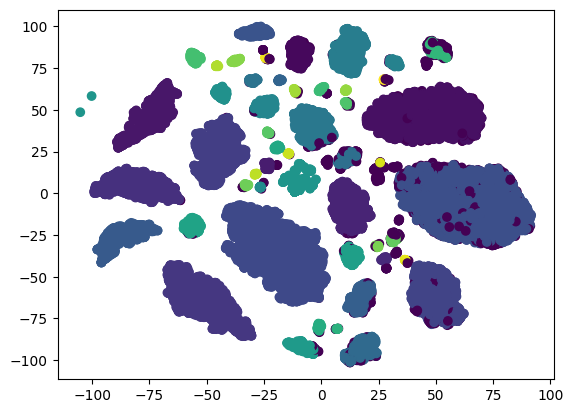

12 ----- score= 0.3545886652231256


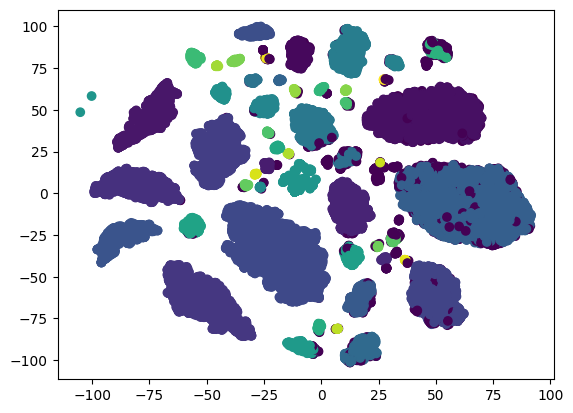

13 ----- score= 0.3522734071550001


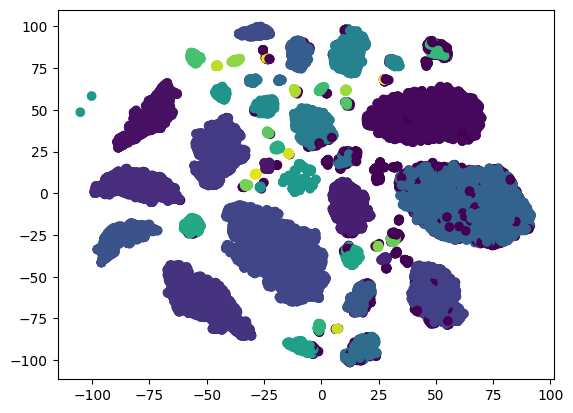

14 ----- score= 0.3514031781163996


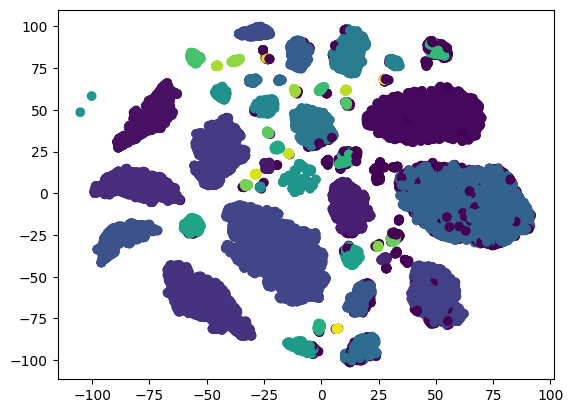

15 ----- score= 0.3499419901372964


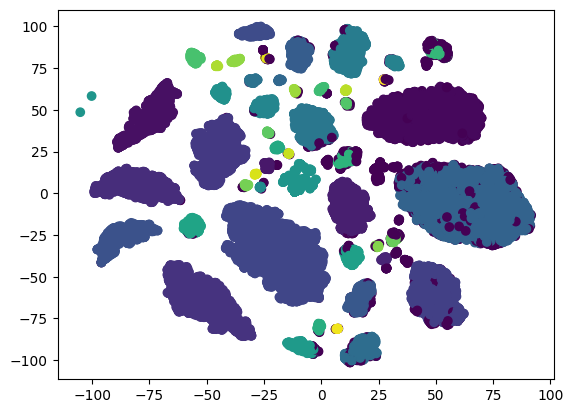

16 ----- score= 0.3485785296095638


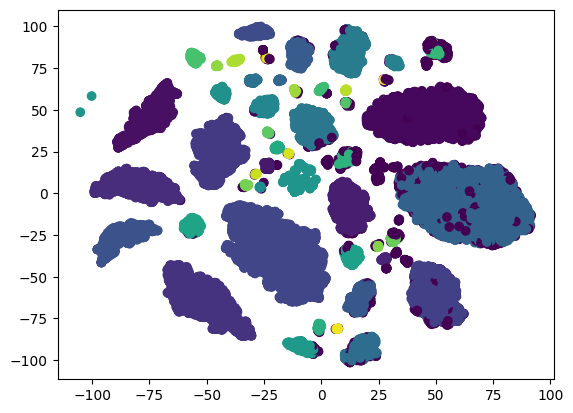

17 ----- score= 0.3463251046830674


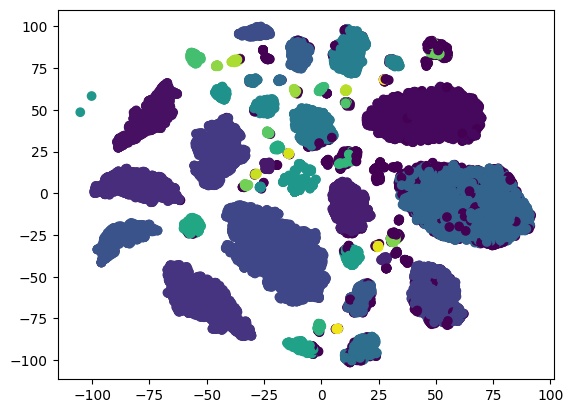

18 ----- score= 0.34436183140263366


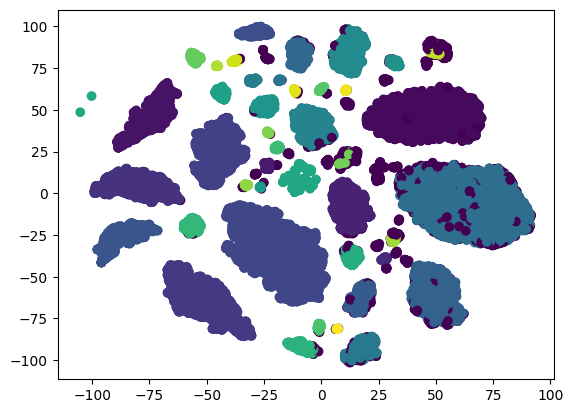

19 ----- score= 0.3425859287622748


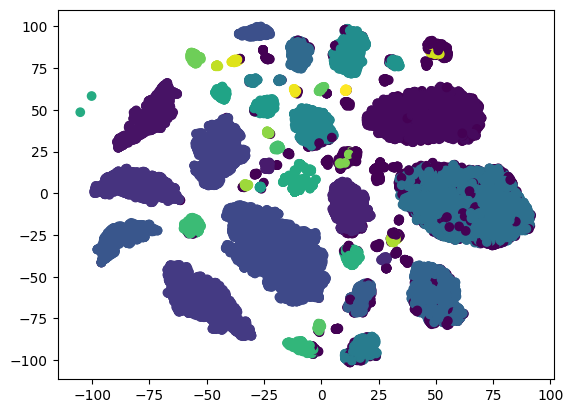

In [ ]:
# dbscan = DBSCAN(eps=0.15, min_samples=50)
# labels_ = dbscan.fit_predict(scaled_data)
# labels_ = [str(l) for l in labels_]
scores =[]
for i in range(1,20,1):
  dbscan = DBSCAN(eps=0.466, min_samples=i)
  labels_ = dbscan.fit_predict(final_df)
  labels_ = [str(l) for l in labels_]
  score=silhouette_score(final_df,dbscan.labels_)
  scores.append(score)
  print(i,"----- score=",score)
  plt.scatter([x[0] for x in two_dimensional_data], [x[1] for x in two_dimensional_data], c=dbscan.labels_)
  plt.show()
  # fig=px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)
  # fig.show()

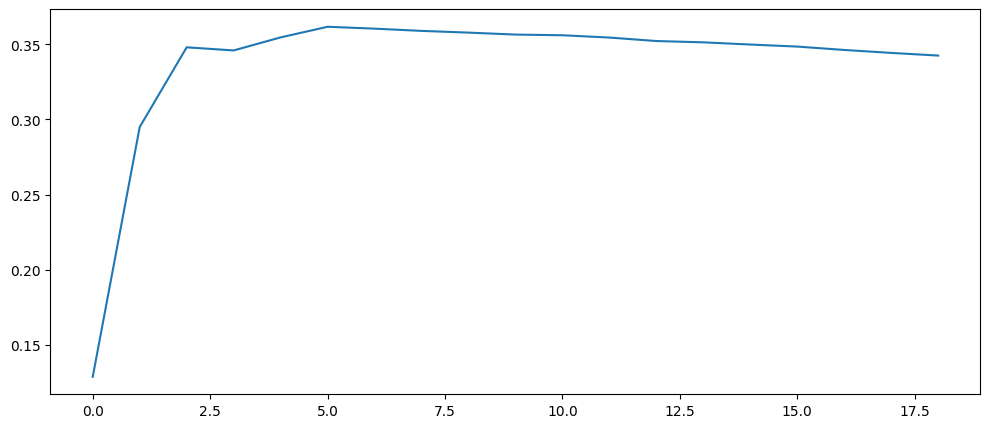

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(range(len(scores)), scores)
plt.show()

In [ ]:
dbscan = DBSCAN(eps=0.466 , min_samples=5)
labels_ = dbscan.fit_predict(final_df)
labels_ = [str(l) for l in labels_]

In [ ]:
px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)

In [ ]:
final_df["labels"]= labels_

In [ ]:
import plotly.express as px
new_df = final_df.groupby("labels").median()[final_df.columns[:-1]].T
fig = px.imshow(new_df, x=new_df.columns, y=new_df.index)
fig.show()

In [ ]:
# فرض می‌کنیم داده‌ها به صورت اولیه و بدون مقیاس‌بندی در final_df هستند
final_df=final_df[final_df.columns[:-1]]
# 1. ترکیب هر 6 ستون به یک ستون بزرگ
combined_column = pd.concat([final_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                             for i in range(0, final_df.shape[1], 6)], axis=1)

# 2. بازگرداندن مقیاس‌بندی Min-Max به حالت اصلی
# فرض کنید `scaler` همان MinMaxScaler است که قبلاً استفاده شده
inversed_combined_df = pd.DataFrame(scaler.inverse_transform(combined_column), columns=combined_column.columns)

# 3. بازگشت از لگاریتم به داده‌های اصلی
original_combined_df = np.exp(inversed_combined_df) - 1

# 4. تقسیم ستون بزرگ به 6 ستون
original_final_df_parts = []
for col in original_combined_df.columns:
    reshaped_part = original_combined_df[col].values.reshape(-1, 6)
    original_final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام بخش‌ها در قالب 6 ستونی
original_final_df = pd.concat(original_final_df_parts, axis=1)

# بازگرداندن نام ستون‌ها به نام‌های اصلی
original_final_df.columns = final_df.columns  # یا همان log_sampled_df.columns

In [ ]:
original_final_df["labels"]= labels_
original_final_df

,MCOR_6-12_weekday,MCOR_12-18_weekday,MCOR_18-24_weekday,MCOR_6-12_weekend,MCOR_12-18_weekend,MCOR_18-24_weekend,MSP_6-12_weekday,MSP_12-18_weekday,MSP_18-24_weekday,MSP_6-12_weekend,...,MSDC_6-12_weekend,MSDC_12-18_weekend,MSDC_18-24_weekend,MCOF_6-12_weekday,MCOF_12-18_weekday,MCOF_18-24_weekday,MCOF_6-12_weekend,MCOF_12-18_weekend,MCOF_18-24_weekend,labels
0,0.000000,0.042553,6.617021,0.000000,0.000000,1.333333,0.000000e+00,19148.936170,1.853404e+06,0.000000,...,0.000000,0.000000,11473.666667,0.000000,1.106383,78.234042,0.000000,0.000000,37.222222,0
1,0.000000,3.595744,0.148936,0.000000,3.444444,0.000000,0.000000e+00,796808.510638,3.914894e+04,0.000000,...,0.000000,6973.555555,0.000000,0.000000,111.893618,2.127660,0.000000,55.444444,0.000000,22
2,0.085107,0.170213,0.148936,0.000000,0.222222,0.444444,3.829787e+04,91276.595745,9.148936e+04,0.000000,...,0.000000,3015.444444,6067.555556,1.340426,2.957447,2.127660,0.000000,2.444444,4.888889,1
3,0.000000,0.000000,0.170212,0.000000,0.000000,0.000000,0.000000e+00,0.000000,6.702128e+04,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,5.170213,0.000000,0.000000,0.000000,2
4,0.000000,0.000000,0.000000,0.111111,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00,27777.777778,...,107.666667,0.000000,0.000000,0.000000,0.000000,0.000000,8.444444,0.000000,0.000000,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,0.021277,1.000000,0.319149,0.111111,1.777778,0.888889,3.617021e+03,241702.127660,6.531915e+04,28888.888889,...,1138.333334,8283.222222,4721.666667,0.404256,27.489362,5.021277,6.111111,58.111111,21.777778,12
19996,0.085106,0.000000,0.000000,0.000000,0.000000,0.000000,2.936170e+04,0.000000,0.000000e+00,0.000000,...,0.000000,0.000000,0.000000,0.574468,0.000000,0.000000,0.000000,0.000000,0.000000,14
19997,4.723404,2.148935,0.829787,1.555556,0.333333,0.666667,1.245745e+06,495106.382978,2.289362e+05,333333.333334,...,9860.000000,2065.333334,4125.111111,132.319149,68.340426,20.106383,36.222222,13.777778,26.333333,12
19998,0.531914,0.319150,1.425531,0.111111,0.111111,7.666667,3.168085e+05,157446.808511,3.651064e+05,42222.222222,...,2116.555556,4000.777778,41871.555556,1.148936,4.744681,21.297872,0.111111,0.111111,108.555555,-1


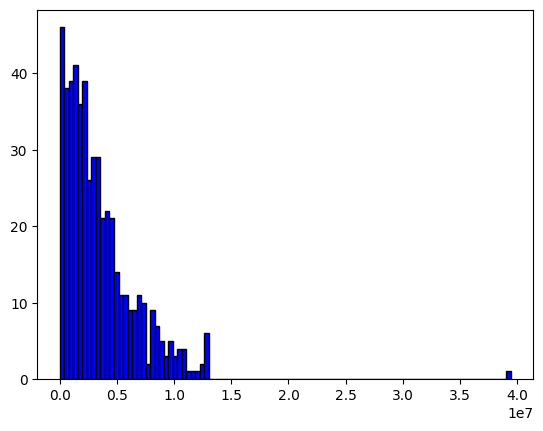

In [ ]:
sum_out=original_final_df[original_final_df["labels"]=="-1"].iloc[:,6:12].sum(axis=1)
# رسم هیستوگرام از مجموع سطرها
plt.hist(sum_out, bins=100, color='blue', edgecolor='black')

plt.show()

# تست روی کل داده ها با هایپر پارامتر های به دست آمده

In [ ]:
sampled_df = processed_data

In [ ]:
log_sampled_df = np.log((sampled_df + 1).astype('float64'))

In [ ]:
# تبدیل هر 6 ستون به یک ستون تکی بزرگ
reshaped_df = pd.concat([log_sampled_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                         for i in range(0, log_sampled_df.shape[1], 6)], axis=1)

# انجام مقیاس‌بندی Min-Max روی ستون تکی بزرگ
scaler = MinMaxScaler()
scaled_df = pd.DataFrame(scaler.fit_transform(reshaped_df), columns=reshaped_df.columns)

# بازگشت داده‌های مقیاس‌بندی‌شده به قالب 6 ستونی
final_df_parts = []
for col in scaled_df.columns:
    # تقسیم هر ستون بزرگ‌شده به 6 بخش و کنار هم قرار دادن آن‌ها
    reshaped_part = scaled_df[col].values.reshape(-1, 6)
    final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام قسمت‌ها در یک DataFrame
final_df = pd.concat(final_df_parts, axis=1)

# برگرداندن نام ستون‌ها به نام‌های اصلی
final_df.columns = log_sampled_df.columns

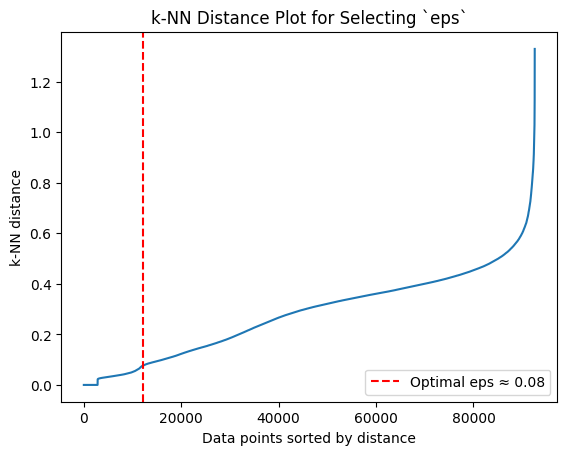

Optimal eps: 0.07715152926382815


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN

# تعیین تعداد نقاط همسایه
k = 50  # به عنوان min_samples انتخاب می‌کنیم

# مدل k-NN برای پیدا کردن نزدیک‌ترین همسایه‌ها
nbrs = NearestNeighbors(n_neighbors=k).fit(final_df)
distances, indices = nbrs.kneighbors(final_df)

# مرتب کردن فاصله‌ها و رسم نمودار
distances = np.sort(distances[:, k-1], axis=0)

# محاسبه مشتق فاصله‌ها
derivative = np.diff(distances)

# پیدا کردن اندیس اولین نقطه‌ای که از یک حد عبور می‌کند
threshold = np.percentile(derivative, 95)  # می‌توانید مقدار درصد را تغییر دهید
eps_index = np.where(derivative > threshold)[0][300]
eps_value = distances[eps_index+5]

# نمایش نتایج
plt.plot(distances)
plt.axvline(eps_index, color='r', linestyle='--', label=f"Optimal eps ≈ {eps_value:.2f}")
plt.ylabel("k-NN distance")
plt.xlabel("Data points sorted by distance")
plt.legend()
plt.title("k-NN Distance Plot for Selecting `eps`")
plt.show()

print("Optimal eps:", eps_value)

In [ ]:
dbscan = DBSCAN(eps=0.466 , min_samples=5)
labels_ = dbscan.fit_predict(final_df)
labels_ = [str(l) for l in labels_]

In [ ]:
two_dimensional_data = TSNE(n_components=2, random_state=42).fit_transform(final_df)

In [ ]:
px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)

In [ ]:
final_df["labels"]= labels_

In [ ]:
import plotly.express as px
new_df = final_df.groupby("labels").median()[final_df.columns[:-1]].T
fig = px.imshow(new_df, x=new_df.columns, y=new_df.index)
fig.show()

In [ ]:
# فرض می‌کنیم داده‌ها به صورت اولیه و بدون مقیاس‌بندی در final_df هستند
final_df=final_df[final_df.columns[:-1]]
# 1. ترکیب هر 6 ستون به یک ستون بزرگ
combined_column = pd.concat([final_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                             for i in range(0, final_df.shape[1], 6)], axis=1)

# 2. بازگرداندن مقیاس‌بندی Min-Max به حالت اصلی
# فرض کنید `scaler` همان MinMaxScaler است که قبلاً استفاده شده
inversed_combined_df = pd.DataFrame(scaler.inverse_transform(combined_column), columns=combined_column.columns)

# 3. بازگشت از لگاریتم به داده‌های اصلی
original_combined_df = np.exp(inversed_combined_df) - 1

# 4. تقسیم ستون بزرگ به 6 ستون
original_final_df_parts = []
for col in original_combined_df.columns:
    reshaped_part = original_combined_df[col].values.reshape(-1, 6)
    original_final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام بخش‌ها در قالب 6 ستونی
original_final_df = pd.concat(original_final_df_parts, axis=1)

# بازگرداندن نام ستون‌ها به نام‌های اصلی
original_final_df.columns = final_df.columns  # یا همان log_sampled_df.columns

In [ ]:
original_final_df["labels"]= labels_
original_final_df

,MCOR_6-12_weekday,MCOR_12-18_weekday,MCOR_18-24_weekday,MCOR_6-12_weekend,MCOR_12-18_weekend,MCOR_18-24_weekend,MSP_6-12_weekday,MSP_12-18_weekday,MSP_18-24_weekday,MSP_6-12_weekend,...,MSDC_6-12_weekend,MSDC_12-18_weekend,MSDC_18-24_weekend,MCOF_6-12_weekday,MCOF_12-18_weekday,MCOF_18-24_weekday,MCOF_6-12_weekend,MCOF_12-18_weekend,MCOF_18-24_weekend,labels
0,2.553190e-01,0.510639,0.404255,3.333333,2.111111,0.000000,8.042553e+04,2.082979e+05,99148.936171,957777.777778,...,35218.777777,23512.666666,0.000000,2.042553,4.872341,1.765957,19.222223,18.444445,0.000000,0
1,0.000000e+00,0.127660,0.063830,0.000000,0.000000,0.000000,0.000000e+00,2.446809e+04,16808.510638,0.000000,...,0.000000,0.000000,0.000000,0.000000,4.468085,0.851064,0.000000,0.000000,0.000000,1
2,4.234042e+00,6.063829,0.000000,0.000000,0.000000,0.000000,8.476596e+05,1.223617e+06,0.000000,0.000000,...,0.000000,0.000000,0.000000,84.170214,118.680850,0.000000,0.000000,0.000000,0.000000,2
3,1.000000e-06,0.042554,0.000000,0.111111,0.000000,0.000000,0.000000e+00,1.297872e+04,0.000000,17777.777778,...,463.444444,0.000000,0.000000,0.000000,0.191489,0.000000,0.444444,0.000000,0.000000,3
4,2.553190e-01,0.787234,0.446809,0.000000,1.444444,1.000000,5.000000e+04,1.251064e+05,85957.446808,0.000000,...,0.000000,4614.555556,3398.888889,1.106383,3.914893,2.638299,0.000000,9.666667,9.777778,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92578,3.042553e+00,0.999999,0.851065,0.222222,0.111111,1.333334,1.381277e+06,6.121277e+05,462765.957447,131111.111112,...,1883.222222,1062.111111,9591.444444,26.553192,17.702127,13.595744,0.888889,0.333333,19.555556,5
92579,9.148940e-01,0.021277,0.000000,0.444444,0.000000,0.000000,3.944681e+05,9.361702e+03,0.000000,221111.111111,...,5438.888889,0.000000,0.000000,19.382979,0.255319,0.000000,11.222222,0.000000,0.000000,12
92580,1.276600e-01,0.127660,1.148936,0.000000,0.777778,0.777778,4.319149e+04,1.131915e+05,511702.127660,0.000000,...,0.000000,3558.555556,14531.444444,1.085106,1.914894,14.276596,0.000000,12.222222,15.555556,4
92581,2.127700e-02,1.297872,0.106383,0.000000,0.888889,0.000000,1.978723e+04,4.163830e+05,40212.765957,0.000000,...,0.000000,10113.000000,0.000000,0.148936,17.425532,0.723404,0.000000,8.666667,0.000000,11


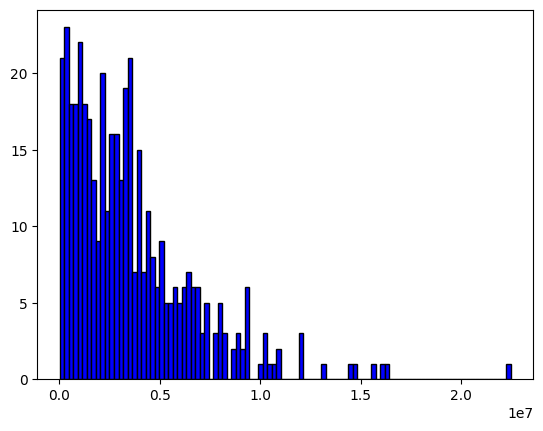

In [ ]:
sum_out=original_final_df[original_final_df["labels"]=="-1"].iloc[:,6:12].sum(axis=1)
# رسم هیستوگرام از مجموع سطرها
plt.hist(sum_out, bins=100, color='blue', edgecolor='black')

plt.show()

# تست روی دو متغییر مسافت و قیمت

In [8]:
sampled_df = processed_data

In [9]:
sampled_df = sampled_df[list(sampled_df.columns[6:12])+list(sampled_df.columns[18:24])]

In [10]:
log_sampled_df = np.log((sampled_df + 1).astype('float64'))

In [11]:
log_sampled_df

,MSP_6-12_weekday,MSP_12-18_weekday,MSP_18-24_weekday,MSP_6-12_weekend,MSP_12-18_weekend,MSP_18-24_weekend,MSDC_6-12_weekday,MSDC_12-18_weekday,MSDC_18-24_weekday,MSDC_6-12_weekend,MSDC_12-18_weekend,MSDC_18-24_weekend
0,11.295099,12.246729,11.504388,13.772372,13.449268,0.000000,7.825058,8.669585,7.957944,10.469363,10.065337,0.000000
1,0.000000,10.105166,9.729700,0.000000,0.000000,0.000000,0.000000,5.768986,5.704208,0.000000,0.000000,0.000000
2,13.650236,14.017323,0.000000,0.000000,0.000000,0.000000,9.399720,9.728844,0.000000,0.000000,0.000000,0.000000
3,0.000000,9.471144,0.000000,9.785761,0.000000,0.000000,0.000000,5.357289,0.000000,6.140842,0.000000,0.000000
4,10.819798,11.736928,11.361619,0.000000,12.369706,12.056547,7.117809,7.901669,7.781210,0.000000,8.437188,8.131498
...,...,...,...,...,...,...,...,...,...,...,...,...
92578,14.138519,13.324698,13.044979,11.783808,11.289794,13.447664,9.682151,8.885526,8.670334,7.541270,6.968955,9.168731
92579,12.885296,9.144489,0.000000,12.306425,0.000000,0.000000,8.704192,4.693298,0.000000,8.601514,0.000000,0.000000
92580,10.673422,11.636845,13.145500,0.000000,12.683000,13.455657,6.953542,7.815164,9.350615,0.000000,8.177391,9.584139
92581,9.892843,12.939363,10.601965,0.000000,12.364978,0.000000,7.096105,9.750705,7.341291,0.000000,9.221676,0.000000


In [12]:
# تبدیل هر 6 ستون به یک ستون تکی بزرگ
reshaped_df = pd.concat([log_sampled_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                         for i in range(0, log_sampled_df.shape[1], 6)], axis=1)

# انجام مقیاس‌بندی Min-Max روی ستون تکی بزرگ
scaler = MinMaxScaler()
scaled_df = pd.DataFrame(scaler.fit_transform(reshaped_df), columns=reshaped_df.columns)

# بازگشت داده‌های مقیاس‌بندی‌شده به قالب 6 ستونی
final_df_parts = []
for col in scaled_df.columns:
    # تقسیم هر ستون بزرگ‌شده به 6 بخش و کنار هم قرار دادن آن‌ها
    reshaped_part = scaled_df[col].values.reshape(-1, 6)
    final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام قسمت‌ها در یک DataFrame
final_df = pd.concat(final_df_parts, axis=1)

# برگرداندن نام ستون‌ها به نام‌های اصلی
final_df.columns = log_sampled_df.columns

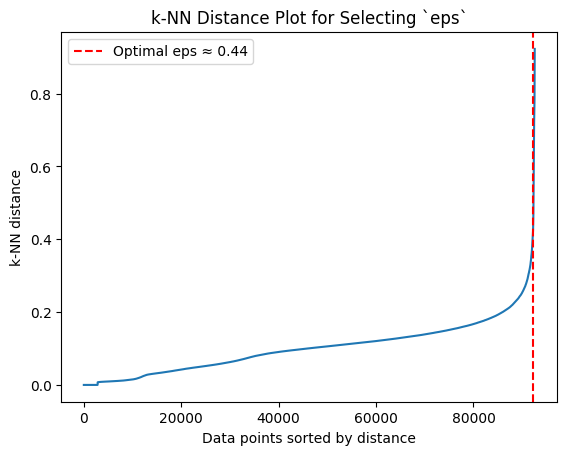

Optimal eps: 0.43765648788580097


In [17]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN

# تعیین تعداد نقاط همسایه
k = 50  # به عنوان min_samples انتخاب می‌کنیم

# مدل k-NN برای پیدا کردن نزدیک‌ترین همسایه‌ها
nbrs = NearestNeighbors(n_neighbors=k).fit(final_df)
distances, indices = nbrs.kneighbors(final_df)

# مرتب کردن فاصله‌ها و رسم نمودار
distances = np.sort(distances[:, k-1], axis=0)

# محاسبه مشتق فاصله‌ها
derivative = np.diff(distances)

# پیدا کردن اندیس اولین نقطه‌ای که از یک حد عبور می‌کند
threshold = np.percentile(derivative, 99.9)  # می‌توانید مقدار درصد را تغییر دهید
eps_index = np.where(derivative > threshold)[0][1]
eps_value = distances[eps_index+5]

# نمایش نتایج
plt.plot(distances)
plt.axvline(eps_index, color='r', linestyle='--', label=f"Optimal eps ≈ {eps_value:.2f}")
plt.ylabel("k-NN distance")
plt.xlabel("Data points sorted by distance")
plt.legend()
plt.title("k-NN Distance Plot for Selecting `eps`")
plt.show()

print("Optimal eps:", eps_value)

In [18]:
dbscan = DBSCAN(eps=0.466 , min_samples=5)
labels_ = dbscan.fit_predict(final_df)
labels_ = [str(l) for l in labels_]

In [19]:
two_dimensional_data = TSNE(n_components=2, random_state=42).fit_transform(final_df)

In [20]:
px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)

15 ----- score= 0.620850997179462


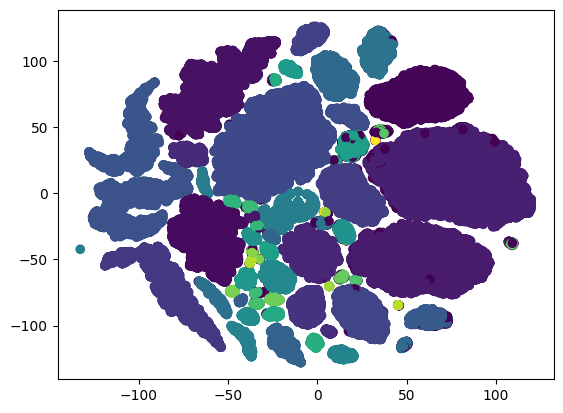

19 ----- score= 0.6429913863441125


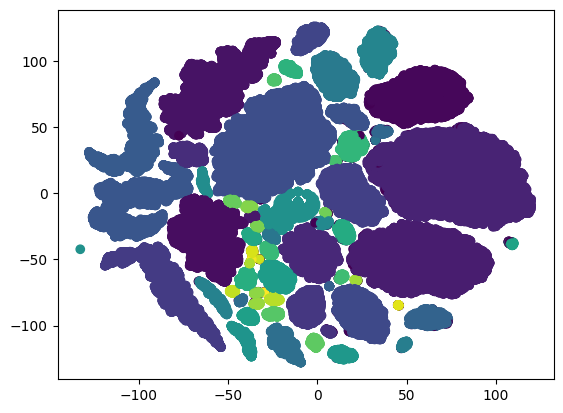

23 ----- score= 0.6446110586556244


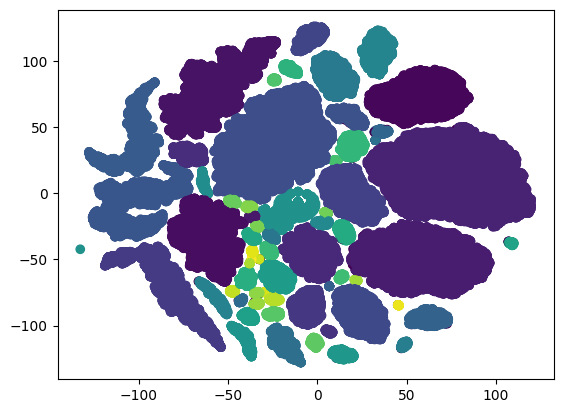

27 ----- score= 0.644965344209826


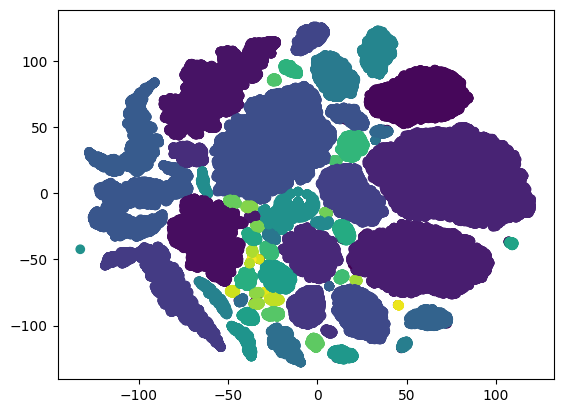

31 ----- score= 0.6450754561381814


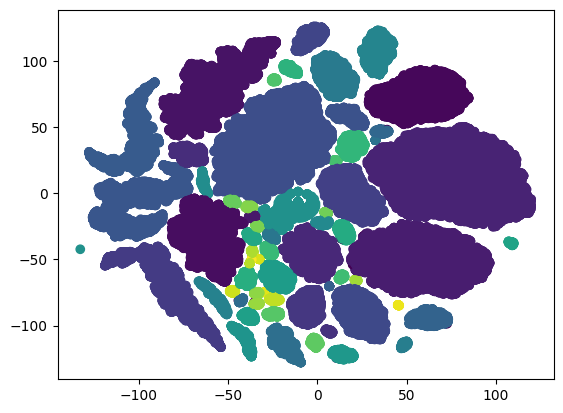

35 ----- score= 0.6451089585230766


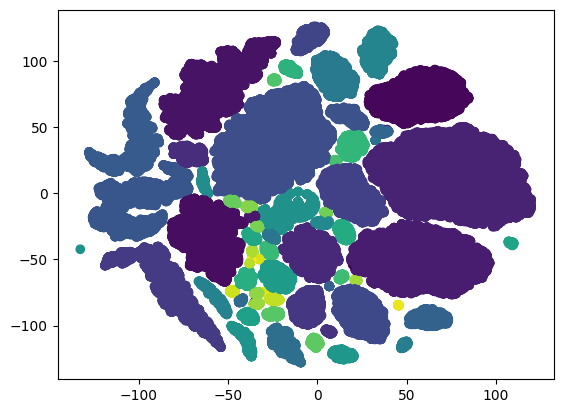

39 ----- score= 0.6451229621383405


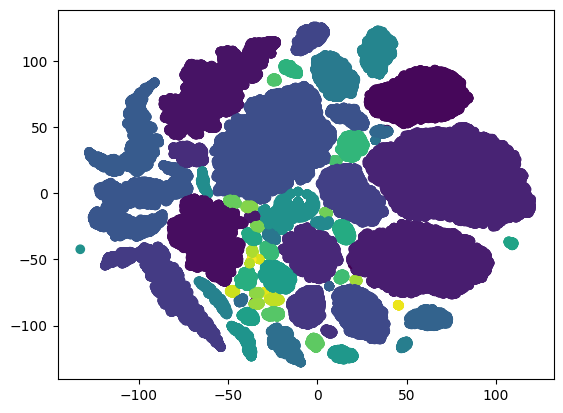

43 ----- score= 0.6451315997738865


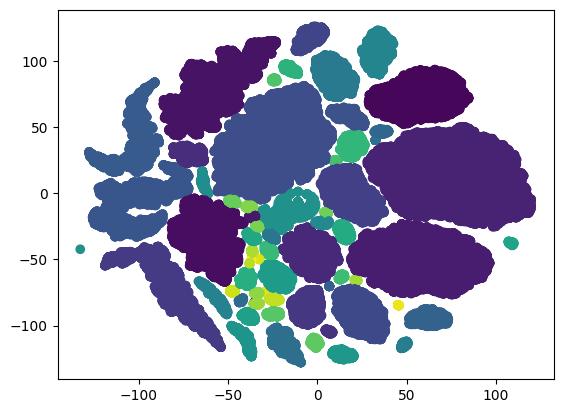

47 ----- score= 0.6451315997738865


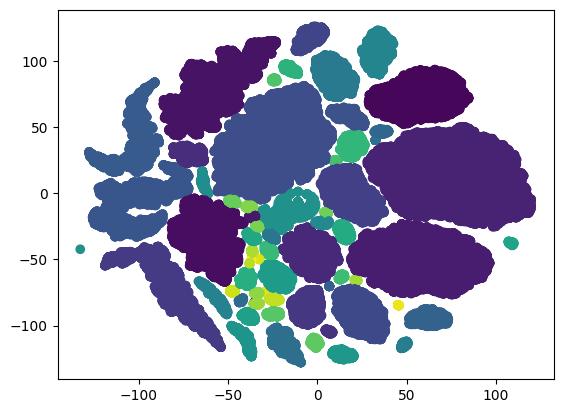

In [ ]:
# dbscan = DBSCAN(eps=0.15, min_samples=50)
# labels_ = dbscan.fit_predict(scaled_data)
# labels_ = [str(l) for l in labels_]
scores =[]
for i in range(15,50,4):
  dbscan = DBSCAN(eps=i/100, min_samples=4)
  labels_ = dbscan.fit_predict(final_df)
  labels_ = [str(l) for l in labels_]
  score=silhouette_score(final_df,dbscan.labels_)
  scores.append(score)
  print(i,"----- score=",score)
  plt.scatter([x[0] for x in two_dimensional_data], [x[1] for x in two_dimensional_data], c=dbscan.labels_)
  plt.show()
  # fig=px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)
  # fig.show()

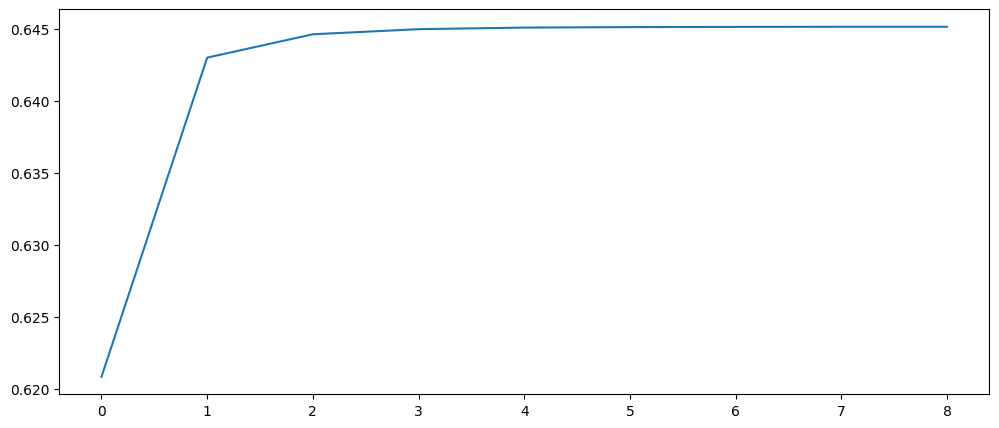

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(range(len(scores)), scores)
plt.show()

In [21]:
final_df["labels"]= labels_

In [22]:
import plotly.express as px
new_df = final_df.groupby("labels").median()[final_df.columns[:-1]].T
fig = px.imshow(new_df, x=new_df.columns, y=new_df.index)
fig.show()

In [23]:
# فرض می‌کنیم داده‌ها به صورت اولیه و بدون مقیاس‌بندی در final_df هستند
final_df=final_df[final_df.columns[:-1]]
# 1. ترکیب هر 6 ستون به یک ستون بزرگ
combined_column = pd.concat([final_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                             for i in range(0, final_df.shape[1], 6)], axis=1)

# 2. بازگرداندن مقیاس‌بندی Min-Max به حالت اصلی
# فرض کنید `scaler` همان MinMaxScaler است که قبلاً استفاده شده
inversed_combined_df = pd.DataFrame(scaler.inverse_transform(combined_column), columns=combined_column.columns)

# 3. بازگشت از لگاریتم به داده‌های اصلی
original_combined_df = np.exp(inversed_combined_df) - 1

# 4. تقسیم ستون بزرگ به 6 ستون
original_final_df_parts = []
for col in original_combined_df.columns:
    reshaped_part = original_combined_df[col].values.reshape(-1, 6)
    original_final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام بخش‌ها در قالب 6 ستونی
original_final_df = pd.concat(original_final_df_parts, axis=1)

# بازگرداندن نام ستون‌ها به نام‌های اصلی
original_final_df.columns = final_df.columns  # یا همان log_sampled_df.columns

In [25]:
original_final_df["labels"]= labels_
processed_data_final=processed_data.copy()
processed_data_final["labels"]=labels_
processed_data_final.to_csv("processed_data_final.csv",index=False)
original_final_df

,MSP_6-12_weekday,MSP_12-18_weekday,MSP_18-24_weekday,MSP_6-12_weekend,MSP_12-18_weekend,MSP_18-24_weekend,MSDC_6-12_weekday,MSDC_12-18_weekday,MSDC_18-24_weekday,MSDC_6-12_weekend,MSDC_12-18_weekend,MSDC_18-24_weekend,labels
0,8.042553e+04,2.082979e+05,99148.936171,957777.777778,693333.333334,0.000000,2501.531915,5822.085107,2857.191489,35218.777777,23512.666666,0.000000,0
1,0.000000e+00,2.446809e+04,16808.510638,0.000000,0.000000,0.000000,0.000000,319.212766,299.127660,0.000000,0.000000,0.000000,1
2,8.476596e+05,1.223617e+06,0.000000,0.000000,0.000000,0.000000,12084.000001,16794.127660,0.000000,0.000000,0.000000,0.000000,2
3,0.000000e+00,1.297872e+04,0.000000,17777.777778,0.000000,0.000000,0.000000,211.148935,0.000000,463.444444,0.000000,0.000000,3
4,5.000000e+04,1.251064e+05,85957.446808,0.000000,235555.555556,172222.222222,1232.744680,2700.787234,2394.170213,0.000000,4614.555556,3398.888889,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
92578,1.381277e+06,6.121277e+05,462765.957447,131111.111112,80000.000000,692222.222223,16027.936170,7225.617021,5826.446808,1883.222222,1062.111111,9591.444444,5
92579,3.944681e+05,9.361702e+03,0.000000,221111.111111,0.000000,0.000000,6027.127660,108.212766,0.000000,5438.888889,0.000000,0.000000,12
92580,4.319149e+04,1.131915e+05,511702.127660,0.000000,322222.222222,697777.777778,1045.851064,2476.893617,11504.893617,0.000000,3558.555556,14531.444444,4
92581,1.978723e+04,4.163830e+05,40212.765957,0.000000,234444.444444,0.000000,1206.255319,17165.319148,1541.702128,0.000000,10113.000000,0.000000,11


In [26]:
processed_data_final


,MCOR_6-12_weekday,MCOR_12-18_weekday,MCOR_18-24_weekday,MCOR_6-12_weekend,MCOR_12-18_weekend,MCOR_18-24_weekend,MSP_6-12_weekday,MSP_12-18_weekday,MSP_18-24_weekday,MSP_6-12_weekend,...,MSDC_6-12_weekend,MSDC_12-18_weekend,MSDC_18-24_weekend,MCOF_6-12_weekday,MCOF_12-18_weekday,MCOF_18-24_weekday,MCOF_6-12_weekend,MCOF_12-18_weekend,MCOF_18-24_weekend,labels
0,0.255319,0.510639,0.404255,3.333333,2.111111,0.000000,8.042553e+04,2.082979e+05,99148.936171,957777.777778,...,35218.777777,23512.666666,0.000000,2.042553,4.872341,1.765957,19.222223,18.444445,0.000000,0
1,0.000000,0.127660,0.063830,0.000000,0.000000,0.000000,0.000000e+00,2.446809e+04,16808.510638,0.000000,...,0.000000,0.000000,0.000000,0.000000,4.468085,0.851064,0.000000,0.000000,0.000000,1
2,4.234042,6.063829,0.000000,0.000000,0.000000,0.000000,8.476596e+05,1.223617e+06,0.000000,0.000000,...,0.000000,0.000000,0.000000,84.170214,118.680850,0.000000,0.000000,0.000000,0.000000,2
3,0.000001,0.042554,0.000000,0.111111,0.000000,0.000000,0.000000e+00,1.297872e+04,0.000000,17777.777778,...,463.444444,0.000000,0.000000,0.000000,0.191489,0.000000,0.444444,0.000000,0.000000,3
4,0.255319,0.787234,0.446809,0.000000,1.444444,1.000000,5.000000e+04,1.251064e+05,85957.446808,0.000000,...,0.000000,4614.555556,3398.888889,1.106383,3.914893,2.638299,0.000000,9.666667,9.777778,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92578,3.042553,0.999999,0.851065,0.222222,0.111111,1.333334,1.381277e+06,6.121277e+05,462765.957447,131111.111112,...,1883.222222,1062.111111,9591.444444,26.553192,17.702127,13.595744,0.888889,0.333333,19.555556,5
92579,0.914894,0.021277,0.000000,0.444444,0.000000,0.000000,3.944681e+05,9.361702e+03,0.000000,221111.111111,...,5438.888889,0.000000,0.000000,19.382979,0.255319,0.000000,11.222222,0.000000,0.000000,12
92580,0.127660,0.127660,1.148936,0.000000,0.777778,0.777778,4.319149e+04,1.131915e+05,511702.127660,0.000000,...,0.000000,3558.555556,14531.444444,1.085106,1.914894,14.276596,0.000000,12.222222,15.555556,4
92581,0.021277,1.297872,0.106383,0.000000,0.888889,-0.000000,1.978723e+04,4.163830e+05,40212.765957,0.000000,...,0.000000,10113.000000,-0.000000,0.148936,17.425532,0.723404,0.000000,8.666667,-0.000000,11


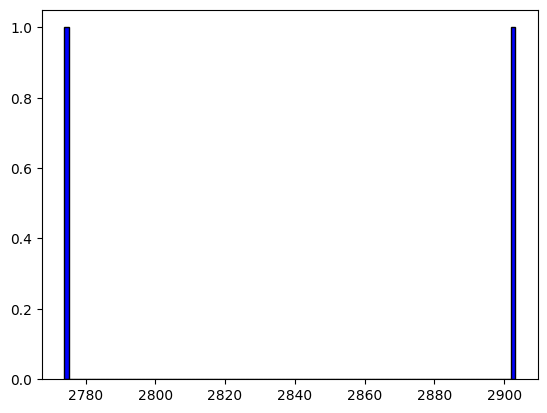

In [ ]:
sum_out=original_final_df[original_final_df["labels"]=="-1"].iloc[:,6:12].sum(axis=1)
# رسم هیستوگرام از مجموع سطرها
plt.hist(sum_out, bins=100, color='blue', edgecolor='black')

plt.show()

# تست روی فقط متغییر قیمت

In [ ]:
sampled_df = processed_data

In [ ]:
sampled_df = sampled_df[list(sampled_df.columns[6:12])]

In [ ]:
log_sampled_df = np.log((sampled_df + 1).astype('float64'))

In [ ]:
log_sampled_df

,MSP_6-12_weekday,MSP_12-18_weekday,MSP_18-24_weekday,MSP_6-12_weekend,MSP_12-18_weekend,MSP_18-24_weekend
0,11.295099,12.246729,11.504388,13.772372,13.449268,0.000000
1,0.000000,10.105166,9.729700,0.000000,0.000000,0.000000
2,13.650236,14.017323,0.000000,0.000000,0.000000,0.000000
3,0.000000,9.471144,0.000000,9.785761,0.000000,0.000000
4,10.819798,11.736928,11.361619,0.000000,12.369706,12.056547
...,...,...,...,...,...,...
92578,14.138519,13.324698,13.044979,11.783808,11.289794,13.447664
92579,12.885296,9.144489,0.000000,12.306425,0.000000,0.000000
92580,10.673422,11.636845,13.145500,0.000000,12.683000,13.455657
92581,9.892843,12.939363,10.601965,0.000000,12.364978,0.000000


In [ ]:
# تبدیل هر 6 ستون به یک ستون تکی بزرگ
reshaped_df = pd.concat([log_sampled_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                         for i in range(0, log_sampled_df.shape[1], 6)], axis=1)

# انجام مقیاس‌بندی Min-Max روی ستون تکی بزرگ
scaler = MinMaxScaler()
scaled_df = pd.DataFrame(scaler.fit_transform(reshaped_df), columns=reshaped_df.columns)

# بازگشت داده‌های مقیاس‌بندی‌شده به قالب 6 ستونی
final_df_parts = []
for col in scaled_df.columns:
    # تقسیم هر ستون بزرگ‌شده به 6 بخش و کنار هم قرار دادن آن‌ها
    reshaped_part = scaled_df[col].values.reshape(-1, 6)
    final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام قسمت‌ها در یک DataFrame
final_df = pd.concat(final_df_parts, axis=1)

# برگرداندن نام ستون‌ها به نام‌های اصلی
final_df.columns = log_sampled_df.columns

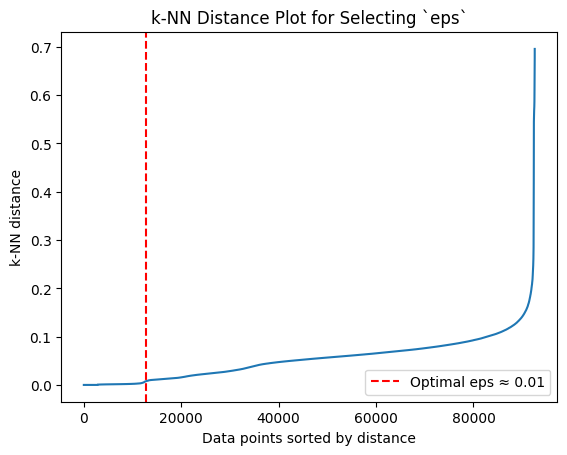

Optimal eps: 0.008085292701305757


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN

# تعیین تعداد نقاط همسایه
k = 50  # به عنوان min_samples انتخاب می‌کنیم

# مدل k-NN برای پیدا کردن نزدیک‌ترین همسایه‌ها
nbrs = NearestNeighbors(n_neighbors=k).fit(final_df)
distances, indices = nbrs.kneighbors(final_df)

# مرتب کردن فاصله‌ها و رسم نمودار
distances = np.sort(distances[:, k-1], axis=0)

# محاسبه مشتق فاصله‌ها
derivative = np.diff(distances)

# پیدا کردن اندیس اولین نقطه‌ای که از یک حد عبور می‌کند
threshold = np.percentile(derivative, 95)  # می‌توانید مقدار درصد را تغییر دهید
eps_index = np.where(derivative > threshold)[0][300]
eps_value = distances[eps_index+5]

# نمایش نتایج
plt.plot(distances)
plt.axvline(eps_index, color='r', linestyle='--', label=f"Optimal eps ≈ {eps_value:.2f}")
plt.ylabel("k-NN distance")
plt.xlabel("Data points sorted by distance")
plt.legend()
plt.title("k-NN Distance Plot for Selecting `eps`")
plt.show()

print("Optimal eps:", eps_value)

In [ ]:
dbscan = DBSCAN(eps=0.44 , min_samples=5)
labels_ = dbscan.fit_predict(final_df)
labels_ = [str(l) for l in labels_]

In [ ]:
two_dimensional_data = TSNE(n_components=2, random_state=42).fit_transform(final_df)

In [ ]:
px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)

5 ----- score= 0.2528011704938328


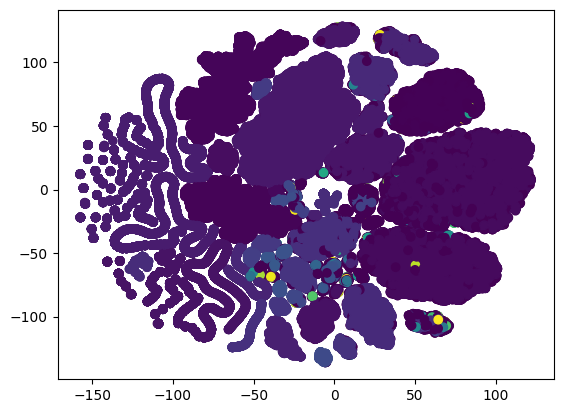

7 ----- score= 0.5489280186652471


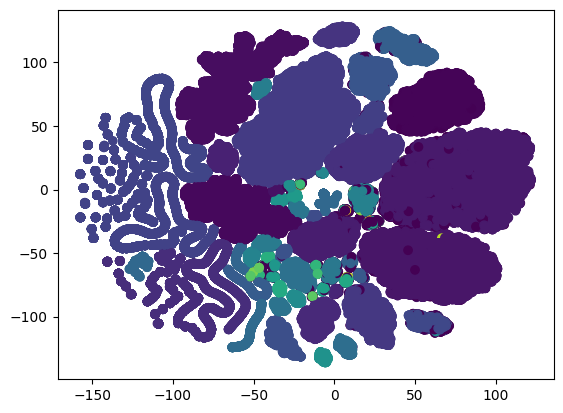

9 ----- score= 0.720261663520566


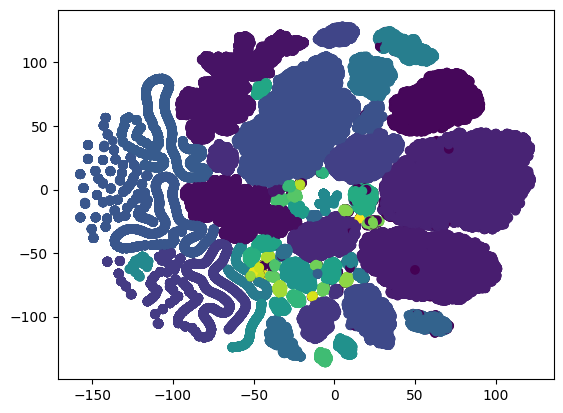

11 ----- score= 0.7248140260405715


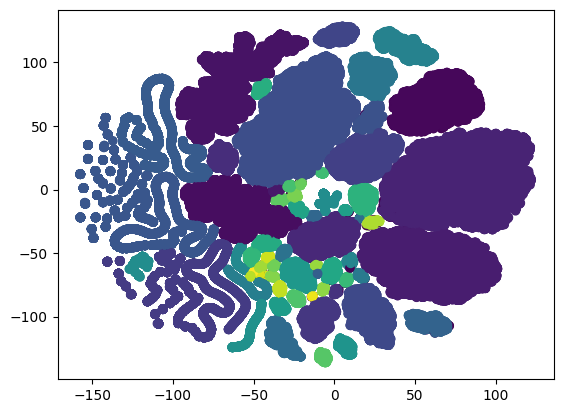

13 ----- score= 0.7258776771224901


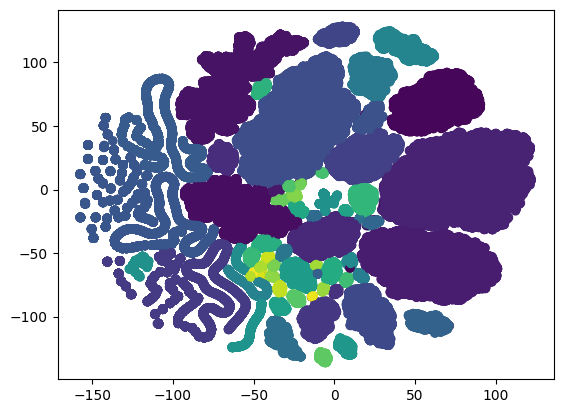

15 ----- score= 0.7263435542588896


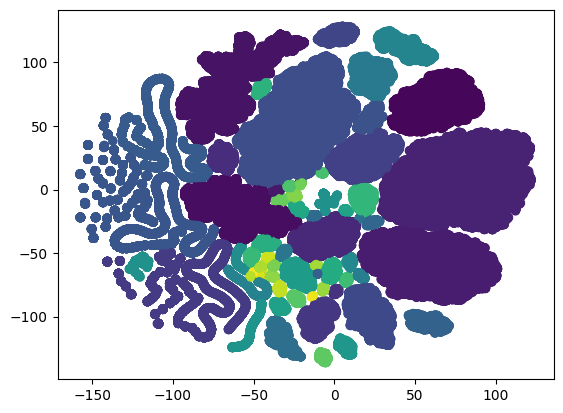

17 ----- score= 0.7264219725464904


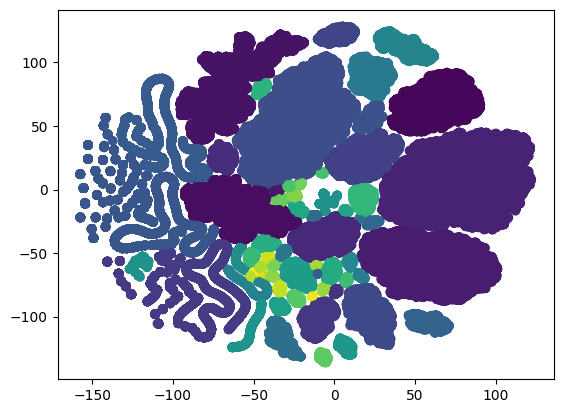

19 ----- score= 0.7264364189984264


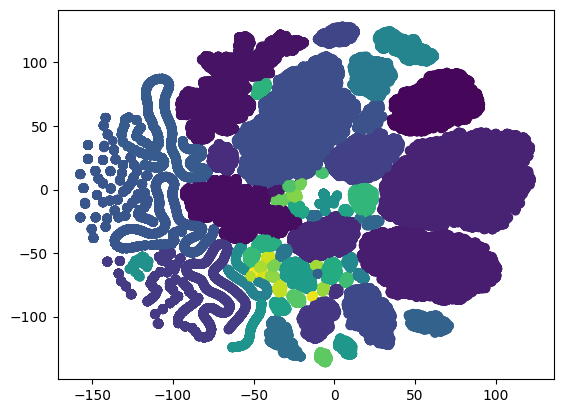

21 ----- score= 0.722799942790317


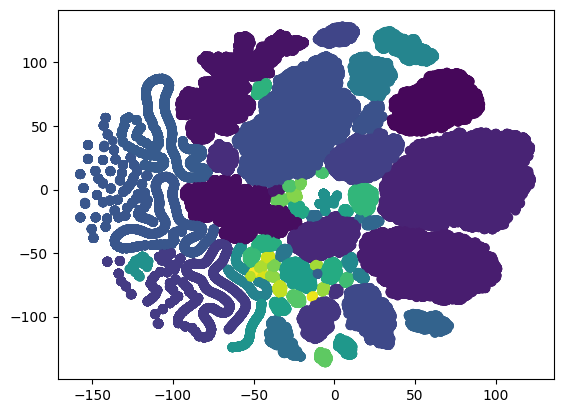

23 ----- score= 0.7264804006056874


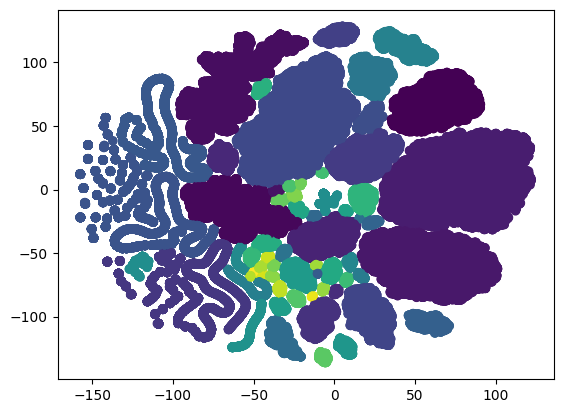

25 ----- score= 0.7264804006056874


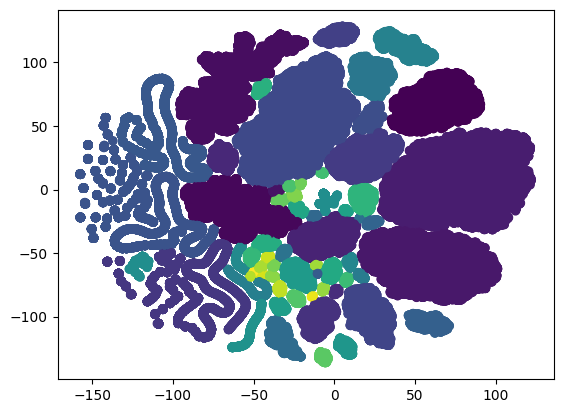

27 ----- score= 0.7264804006056874


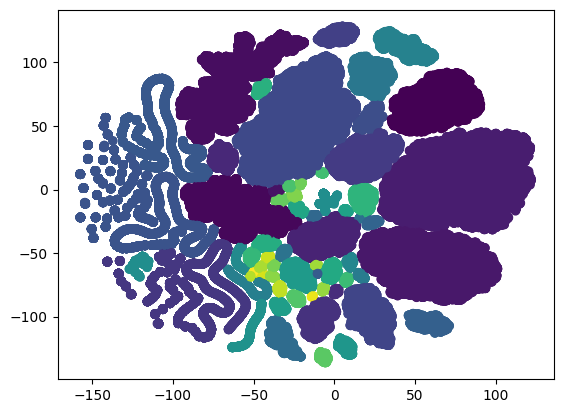

29 ----- score= 0.7264804006056874


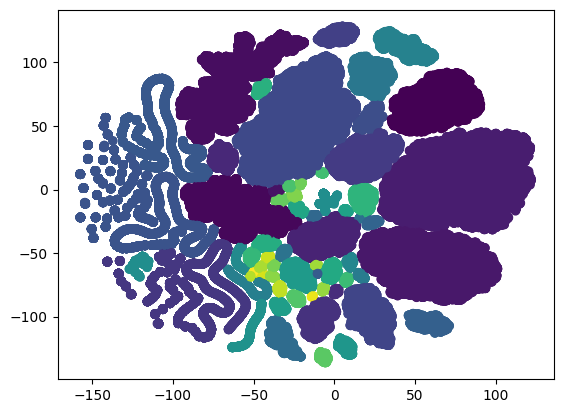

31 ----- score= 0.7264804006056874


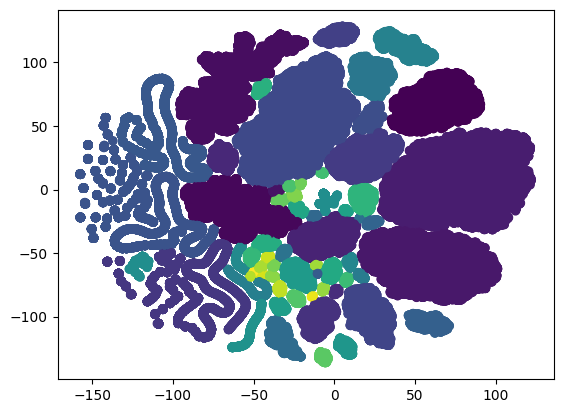

33 ----- score= 0.7264804006056874


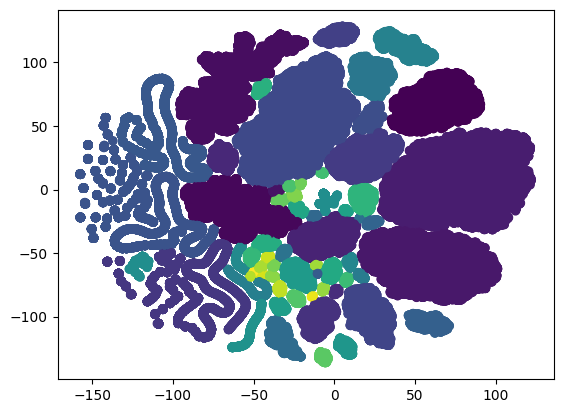

35 ----- score= 0.7264804006056874


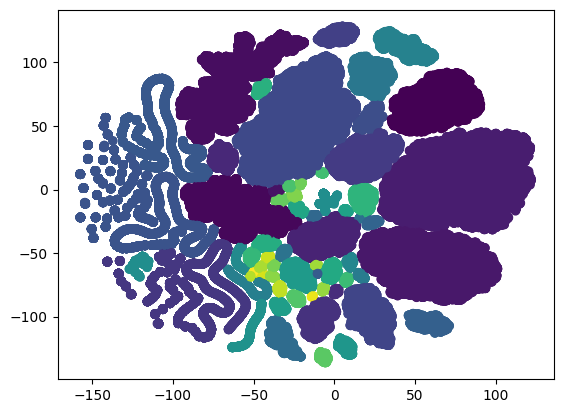

37 ----- score= 0.7264804006056874


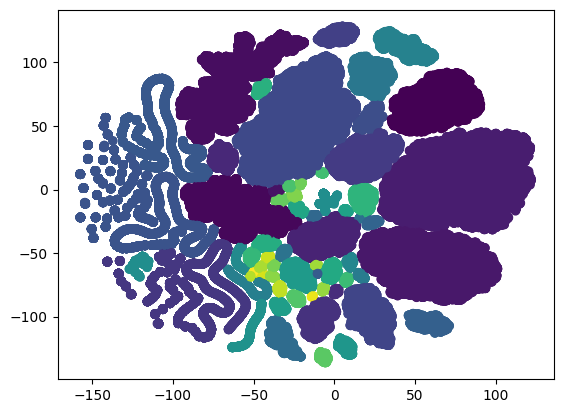

39 ----- score= 0.7264804006056874


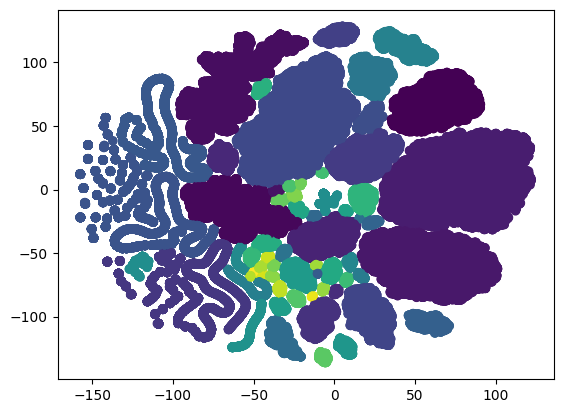

41 ----- score= 0.7264804006056874


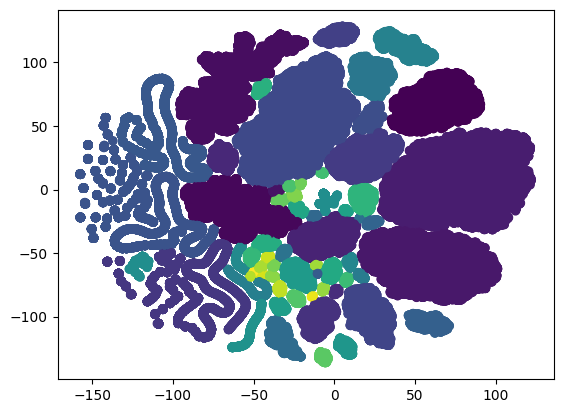

43 ----- score= 0.7264804006056874


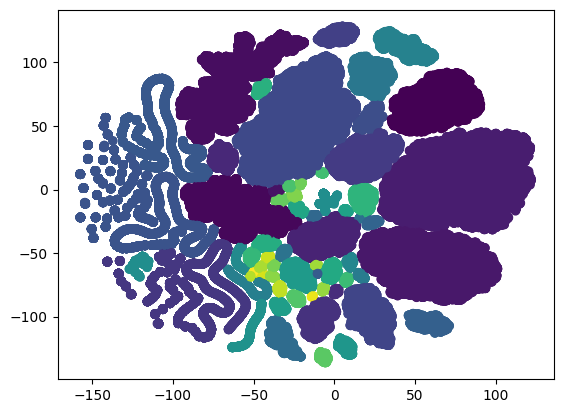

45 ----- score= 0.7264804006056874


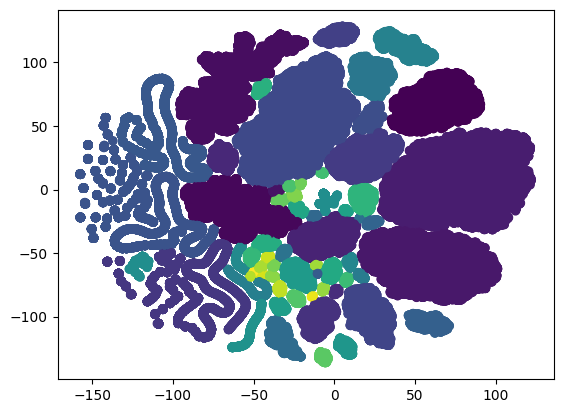

47 ----- score= 0.3931842758955009


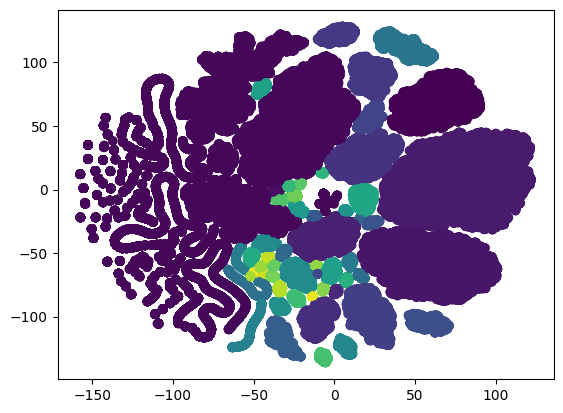

49 ----- score= 0.34731297927805715


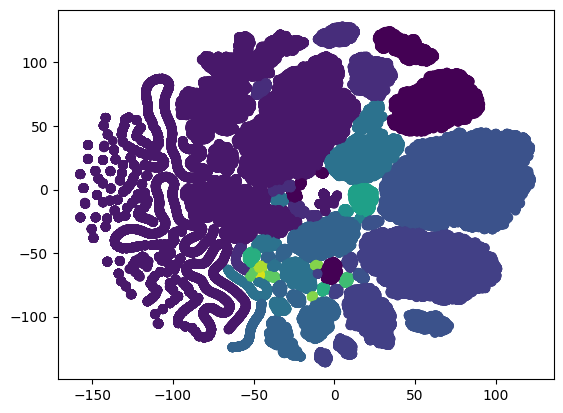

In [ ]:
# dbscan = DBSCAN(eps=0.15, min_samples=50)
# labels_ = dbscan.fit_predict(scaled_data)
# labels_ = [str(l) for l in labels_]
scores =[]
for i in range(5,50,2):
  dbscan = DBSCAN(eps=i/100, min_samples=4)
  labels_ = dbscan.fit_predict(final_df)
  labels_ = [str(l) for l in labels_]
  score=silhouette_score(final_df,dbscan.labels_)
  scores.append(score)
  print(i,"----- score=",score)
  plt.scatter([x[0] for x in two_dimensional_data], [x[1] for x in two_dimensional_data], c=dbscan.labels_)
  plt.show()
  # fig=px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)
  # fig.show()

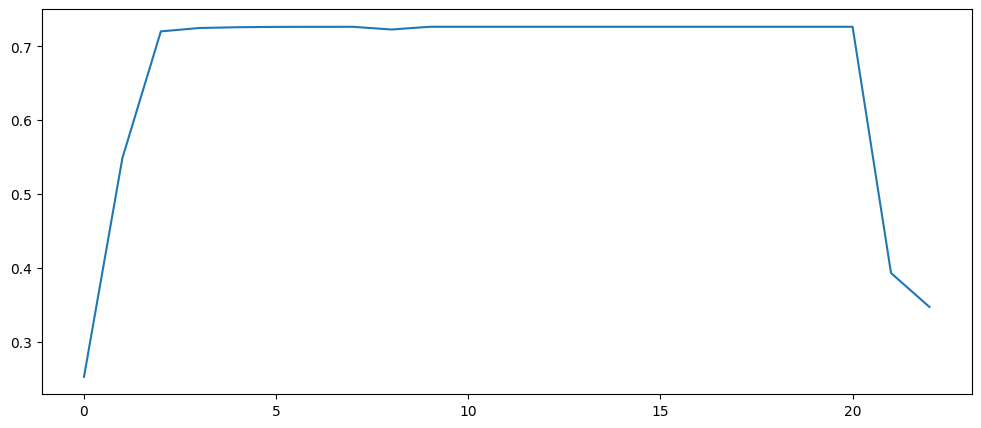

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(range(len(scores)), scores)
plt.show()

In [ ]:
dbscan = DBSCAN(eps=0.19 , min_samples=5)
labels_ = dbscan.fit_predict(final_df)
labels_ = [str(l) for l in labels_]

In [ ]:
px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)

In [ ]:
final_df["labels"]= labels_

In [ ]:
import plotly.express as px
new_df = final_df.groupby("labels").median()[final_df.columns[:-1]].T
fig = px.imshow(new_df, x=new_df.columns, y=new_df.index)
fig.show()

In [ ]:
# فرض می‌کنیم داده‌ها به صورت اولیه و بدون مقیاس‌بندی در final_df هستند
final_df=final_df[final_df.columns[:-1]]
# 1. ترکیب هر 6 ستون به یک ستون بزرگ
combined_column = pd.concat([final_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                             for i in range(0, final_df.shape[1], 6)], axis=1)

# 2. بازگرداندن مقیاس‌بندی Min-Max به حالت اصلی
# فرض کنید `scaler` همان MinMaxScaler است که قبلاً استفاده شده
inversed_combined_df = pd.DataFrame(scaler.inverse_transform(combined_column), columns=combined_column.columns)

# 3. بازگشت از لگاریتم به داده‌های اصلی
original_combined_df = np.exp(inversed_combined_df) - 1

# 4. تقسیم ستون بزرگ به 6 ستون
original_final_df_parts = []
for col in original_combined_df.columns:
    reshaped_part = original_combined_df[col].values.reshape(-1, 6)
    original_final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام بخش‌ها در قالب 6 ستونی
original_final_df = pd.concat(original_final_df_parts, axis=1)

# بازگرداندن نام ستون‌ها به نام‌های اصلی
original_final_df.columns = final_df.columns  # یا همان log_sampled_df.columns

In [ ]:
original_final_df["labels"]= labels_
original_final_df

,MSP_6-12_weekday,MSP_12-18_weekday,MSP_18-24_weekday,MSP_6-12_weekend,MSP_12-18_weekend,MSP_18-24_weekend,labels
0,8.042553e+04,2.082979e+05,99148.936171,957777.777778,693333.333334,0.000000,0
1,0.000000e+00,2.446809e+04,16808.510638,0.000000,0.000000,0.000000,1
2,8.476596e+05,1.223617e+06,0.000000,0.000000,0.000000,0.000000,1
3,0.000000e+00,1.297872e+04,0.000000,17777.777778,0.000000,0.000000,2
4,5.000000e+04,1.251064e+05,85957.446808,0.000000,235555.555556,172222.222222,3
...,...,...,...,...,...,...,...
92578,1.381277e+06,6.121277e+05,462765.957447,131111.111112,80000.000000,692222.222223,4
92579,3.944681e+05,9.361702e+03,0.000000,221111.111111,0.000000,0.000000,2
92580,4.319149e+04,1.131915e+05,511702.127660,0.000000,322222.222222,697777.777778,3
92581,1.978723e+04,4.163830e+05,40212.765957,0.000000,234444.444444,0.000000,6


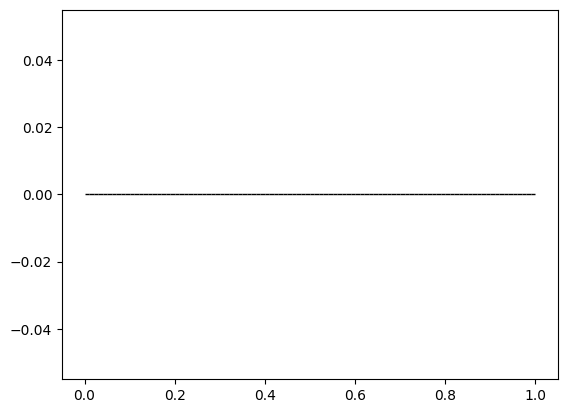

In [ ]:
sum_out=original_final_df[original_final_df["labels"]=="-1"].iloc[:,6:12].sum(axis=1)
# رسم هیستوگرام از مجموع سطرها
plt.hist(sum_out, bins=100, color='blue', edgecolor='black')

plt.show()

# تست روی فقط متغییر فاصله

In [ ]:
sampled_df = processed_data

In [ ]:
sampled_df = sampled_df[list(sampled_df.columns[18:24])]

In [ ]:
log_sampled_df = np.log((sampled_df + 1).astype('float64'))

In [ ]:
log_sampled_df

In [ ]:
# تبدیل هر 6 ستون به یک ستون تکی بزرگ
reshaped_df = pd.concat([log_sampled_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                         for i in range(0, log_sampled_df.shape[1], 6)], axis=1)

# انجام مقیاس‌بندی Min-Max روی ستون تکی بزرگ
scaler = MinMaxScaler()
scaled_df = pd.DataFrame(scaler.fit_transform(reshaped_df), columns=reshaped_df.columns)

# بازگشت داده‌های مقیاس‌بندی‌شده به قالب 6 ستونی
final_df_parts = []
for col in scaled_df.columns:
    # تقسیم هر ستون بزرگ‌شده به 6 بخش و کنار هم قرار دادن آن‌ها
    reshaped_part = scaled_df[col].values.reshape(-1, 6)
    final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام قسمت‌ها در یک DataFrame
final_df = pd.concat(final_df_parts, axis=1)

# برگرداندن نام ستون‌ها به نام‌های اصلی
final_df.columns = log_sampled_df.columns

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN

# تعیین تعداد نقاط همسایه
k = 50  # به عنوان min_samples انتخاب می‌کنیم

# مدل k-NN برای پیدا کردن نزدیک‌ترین همسایه‌ها
nbrs = NearestNeighbors(n_neighbors=k).fit(final_df)
distances, indices = nbrs.kneighbors(final_df)

# مرتب کردن فاصله‌ها و رسم نمودار
distances = np.sort(distances[:, k-1], axis=0)

# محاسبه مشتق فاصله‌ها
derivative = np.diff(distances)

# پیدا کردن اندیس اولین نقطه‌ای که از یک حد عبور می‌کند
threshold = np.percentile(derivative, 95)  # می‌توانید مقدار درصد را تغییر دهید
eps_index = np.where(derivative > threshold)[0][300]
eps_value = distances[eps_index+5]

# نمایش نتایج
plt.plot(distances)
plt.axvline(eps_index, color='r', linestyle='--', label=f"Optimal eps ≈ {eps_value:.2f}")
plt.ylabel("k-NN distance")
plt.xlabel("Data points sorted by distance")
plt.legend()
plt.title("k-NN Distance Plot for Selecting `eps`")
plt.show()

print("Optimal eps:", eps_value)

In [ ]:
dbscan = DBSCAN(eps=0.14 , min_samples=5)
labels_ = dbscan.fit_predict(final_df)
labels_ = [str(l) for l in labels_]

In [ ]:
two_dimensional_data = TSNE(n_components=2, random_state=42).fit_transform(final_df)

In [ ]:
px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)

In [ ]:
# dbscan = DBSCAN(eps=0.15, min_samples=50)
# labels_ = dbscan.fit_predict(scaled_data)
# labels_ = [str(l) for l in labels_]
scores =[]
for i in range(5,30,1):
  dbscan = DBSCAN(eps=i/100, min_samples=4)
  labels_ = dbscan.fit_predict(final_df)
  labels_ = [str(l) for l in labels_]
  score=silhouette_score(final_df,dbscan.labels_)
  scores.append(score)
  print(i,"----- score=",score)
  plt.scatter([x[0] for x in two_dimensional_data], [x[1] for x in two_dimensional_data], c=dbscan.labels_)
  plt.show()
  # fig=px.scatter(x=two_dimensional_data[:, 0], y=two_dimensional_data[:, 1], color=labels_)
  # fig.show()

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(range(len(scores)), scores)
plt.show()

In [ ]:
final_df["labels"]= labels_

In [ ]:
import plotly.express as px
new_df = final_df.groupby("labels").median()[final_df.columns[:-1]].T
fig = px.imshow(new_df, x=new_df.columns, y=new_df.index)
fig.show()

In [ ]:
# فرض می‌کنیم داده‌ها به صورت اولیه و بدون مقیاس‌بندی در final_df هستند
final_df=final_df[final_df.columns[:-1]]
# 1. ترکیب هر 6 ستون به یک ستون بزرگ
combined_column = pd.concat([final_df.iloc[:, i:i+6].stack().reset_index(drop=True)
                             for i in range(0, final_df.shape[1], 6)], axis=1)

# 2. بازگرداندن مقیاس‌بندی Min-Max به حالت اصلی
# فرض کنید `scaler` همان MinMaxScaler است که قبلاً استفاده شده
inversed_combined_df = pd.DataFrame(scaler.inverse_transform(combined_column), columns=combined_column.columns)

# 3. بازگشت از لگاریتم به داده‌های اصلی
original_combined_df = np.exp(inversed_combined_df) - 1

# 4. تقسیم ستون بزرگ به 6 ستون
original_final_df_parts = []
for col in original_combined_df.columns:
    reshaped_part = original_combined_df[col].values.reshape(-1, 6)
    original_final_df_parts.append(pd.DataFrame(reshaped_part))

# ادغام نهایی تمام بخش‌ها در قالب 6 ستونی
original_final_df = pd.concat(original_final_df_parts, axis=1)

# بازگرداندن نام ستون‌ها به نام‌های اصلی
original_final_df.columns = final_df.columns  # یا همان log_sampled_df.columns

In [ ]:
original_final_df["labels"]= labels_
original_final_df

In [ ]:
sum_out=original_final_df[original_final_df["labels"]=="-1"].iloc[:,6:12].sum(axis=1)
# رسم هیستوگرام از مجموع سطرها
plt.hist(sum_out, bins=100, color='blue', edgecolor='black')

plt.show()